<h1 style="text-align: center; font-weight: bold;">Data Sciense Course - Spring 1403</h1>
<h1 style="text-align: center; font-weight: bold;">Project Phase1 - Introduction to Data Science </h1>
<h1 style="text-align: center;">Mohammadreza Mohammadhashemi : 810100206</h1>
<h1 style="text-align: center;">Soheil Hajian Manesh : 810100119</h1>
<h1 style="text-align: center;">Mahdi Ebrahimi Soltani : 810100241</h1>


# Problem Description
In this phase of our project, we will be focusing on web scraping data from the **Fiverr.com** website using BeautifulSoup and Selenium. The goal is to extract meaningful statistics from the dataset through exploratory data analysis (EDA), visualization, and preprocessing steps.**Fiverr.com** is an online marketplace that connects freelancers with clients who need various services. Launched in 2010, Fiverr offers a wide range of digital services, known as "gigs," which include categories such as graphic design, writing, translation, video editing, programming, digital marketing, and more.
We collect about 6000 data records from 10 different categories.

In [220]:
import pandas as pd
import numpy as np
from ydata_profiling import ProfileReport
from ydata_profiling.config import Settings
from ydata_profiling.report.presentation.flavours.html import templates
import matplotlib.pyplot as plt
import seaborn as sns
import gc
import scipy.stats as stats

In [221]:
df = pd.read_csv("./Fiverr Dataset.csv")

In [222]:
df.drop_duplicates(inplace=True)

In [223]:
def print_unique_elements(df, columns):
    for column in columns:
        try:
            print(f"\033[94m{column}\033[0m:")
            unique_counts = df[column].value_counts()
            i = 0
            for value, count in unique_counts.items():
                i = i + 1
                print(f"        \033[91m{value}\033[0m {count}")
        except KeyError:
            print(f"    Column '{column}' not found in the DataFrame.")

In [224]:
print_unique_elements(df, ['Basic Price'])

Basic Price:
        $10 1031
        $5 761
        $30 598
        $100 586
        $15 532
        $50 496
        $20 487
        $25 390
        $150 257
        $40 242
        $35 223
        $80 164
        $200 149
        $45 146
        $60 138
        $90 116
        $75 112
        $250 101
        $70 96
        $120 88
        $125 87
        $300 85
        $65 73
        €9.67 66
        $500 59
        $55 57
        $95 54
        €4.84 44
        $350 42
        $85 42
        $140 41
        €19.34 34
        €14.51 33
        €29.01 33
        $180 32
        $110 32
        $400 30
        $130 30
        $105 27
        €48.36 27
        €96.72 26
        $195 26
        $145 24
        $175 20
        $160 20
        $135 20
        $1,000 20
        $600 19
        €145.07 19
        $115 19
        $450 18
        €9.78 18
        €24.18 17
        $190 14
        $170 13
        $245 12
        $225 12
        $295 12
        US$30 11
        €87.04 11
     

In [225]:
df['Seller In Same Level'] = df['Seller In Same Level'].str.replace(',', '').str.replace('+', '').str.extract('(\d+)').astype(int)


<>:1: SyntaxWarning: invalid escape sequence '\d'
<>:1: SyntaxWarning: invalid escape sequence '\d'
C:\Users\Mahdi\AppData\Local\Temp\ipykernel_19836\2597413571.py:1: SyntaxWarning: invalid escape sequence '\d'
  df['Seller In Same Level'] = df['Seller In Same Level'].str.replace(',', '').str.replace('+', '').str.extract('(\d+)').astype(int)


In [226]:
print_unique_elements(df, ['Seller In Same Level'])

Seller In Same Level:
        1000 226
        2200 186
        2800 183
        2000 175
        12000 139
        1200 137
        313 130
        1700 96
        8900 96
        1800 94
        4300 94
        2700 94
        5800 93
        606 92
        2400 91
        1100 91
        1900 91
        652 90
        329 90
        14000 89
        533 89
        76 77
        461 77
        23 68
        27 54
        6100 48
        6200 48
        928 48
        8349 48
        46000 48
        683 48
        53000 48
        3800 48
        15000 48
        147 48
        26000 48
        548 48
        6000 48
        44000 48
        298 48
        1773 48
        336 48
        5600 48
        2100 48
        33000 48
        361 48
        5500 48
        2248 48
        2900 48
        995 48
        348 48
        314 48
        5900 48
        50472 48
        16000 48
        7281 48
        1600 47
        15101 47
        5510 47
        641 47
        620 47
        

In [227]:
df['Basic Price'] = df['Basic Price'].str.split("Save up to").str[0]
print_unique_elements(df, ['Basic Price'])

Basic Price:
        $10 1047
        $5 777
        $30 612
        $100 595
        $15 550
        $50 509
        $20 503
        $25 400
        $150 261
        $40 248
        $35 225
        $80 166
        $45 153
        $200 153
        $60 143
        $90 116
        $75 113
        $250 105
        $70 96
        $125 92
        $120 89
        $300 85
        $65 73
        €9.67 67
        $500 60
        $55 57
        $95 56
        €4.84 44
        $350 42
        $85 42
        $140 41
        €19.34 34
        €29.01 34
        €14.51 33
        $180 32
        $110 32
        $400 30
        $130 30
        €48.36 29
        $105 27
        $195 26
        €96.72 26
        $145 24
        $1,000 21
        $160 20
        $135 20
        $175 20
        €145.07 19
        $600 19
        $115 19
        $450 18
        €9.78 18
        €24.18 17
        $190 14
        $170 14
        $245 12
        $225 12
        $295 12
        €87.04 11
        US$30 11
     

In [228]:
from forex_python.converter import CurrencyRates

def find_exchange_rates():
    try:
        cr = CurrencyRates()
        euro_ex_rate = cr.get_rate('EUR', 'USD')
        shekle_ex_rate = cr.get_rate('ILS', 'USD')
        pound_ex_rate = cr.get_rate('GBP', 'USD')
        cad_ex_usd_rate = cr.get_rate('CAD', 'USD')
        return {'$': 1, '€': euro_ex_rate, '₪': shekle_ex_rate, 'US$': 1, '£': pound_ex_rate, 'CA$' : cad_ex_usd_rate}  
    except :
        return {'$': 1, '€': 1.08, '₪': 0.27, 'US$': 1, '£': 1.27, 'CA$' : 0.72} 

In [229]:
exchange_rates = find_exchange_rates()

def convert_to_usd(price):
    for currency, exchange_rate in exchange_rates.items():
        if price.startswith(currency):
            numeric_price = float(price.lstrip(currency).replace(',', ''))
            return round(numeric_price / exchange_rate, 2)
    return price

df['Basic Price'] = df['Basic Price'].apply(convert_to_usd)


In [230]:
print_unique_elements(df, ['Basic Price'])

Basic Price:
        10.0 1055
        5.0 784
        30.0 623
        100.0 601
        15.0 558
        50.0 515
        20.0 508
        25.0 406
        150.0 263
        40.0 248
        35.0 230
        80.0 166
        45.0 155
        200.0 154
        60.0 143
        90.0 116
        75.0 113
        250.0 106
        70.0 98
        125.0 92
        120.0 90
        300.0 86
        65.0 74
        8.95 67
        500.0 62
        55.0 60
        95.0 58
        4.48 44
        350.0 43
        85.0 42
        140.0 41
        17.91 34
        26.86 34
        13.44 33
        110.0 33
        180.0 32
        130.0 31
        400.0 30
        44.78 29
        105.0 27
        195.0 26
        89.56 26
        145.0 24
        1000.0 21
        135.0 20
        115.0 20
        160.0 20
        175.0 20
        600.0 19
        134.32 19
        9.06 18
        450.0 18
        22.39 17
        190.0 15
        170.0 14
        295.0 13
        245.0 12
        225.0 12
   

In [231]:
df['Standard Price'] = df['Standard Price'].str.split("Save up to").str[0]
df['Standard Price'] = df['Standard Price'].apply(convert_to_usd)
print_unique_elements(df, ['Standard Price'])

Standard Price:
        50.0 513
        20.0 448
        30.0 410
        10.0 382
        100.0 365
        25.0 355
        40.0 330
        15.0 325
        150.0 319
        60.0 260
        200.0 255
        250.0 226
        80.0 205
        35.0 196
        70.0 176
        75.0 173
        45.0 171
        300.0 169
        120.0 158
        5.0 153
        90.0 138
        500.0 114
        125.0 96
        350.0 93
        400.0 92
        65.0 85
        55.0 82
        180.0 76
        95.0 74
        130.0 71
        140.0 63
        600.0 59
        160.0 58
        110.0 55
        450.0 54
        85.0 51
        1000.0 50
        175.0 45
        195.0 42
        550.0 40
        1500.0 37
        190.0 35
        225.0 31
        44.78 30
        295.0 30
        155.0 29
        750.0 28
        115.0 28
        17.91 27
        220.0 27
        240.0 27
        170.0 26
        800.0 26
        8.95 25
        26.86 25
        280.0 23
        700.0 22
        230.

In [232]:
df['Premium Price'] = df['Premium Price'].str.split("Save up to").str[0]
df['Premium Price'] = df['Premium Price'].apply(convert_to_usd)
print_unique_elements(df, ['Premium Price'])

Premium Price:
        100.0 499
        50.0 430
        150.0 309
        200.0 308
        30.0 299
        60.0 236
        300.0 236
        20.0 228
        40.0 220
        250.0 216
        500.0 202
        25.0 192
        15.0 186
        120.0 180
        80.0 172
        400.0 153
        5.0 153
        90.0 146
        45.0 141
        350.0 135
        75.0 135
        10.0 130
        35.0 130
        70.0 115
        180.0 100
        600.0 95
        450.0 90
        1000.0 90
        65.0 84
        125.0 84
        55.0 76
        95.0 75
        130.0 71
        85.0 67
        800.0 65
        1500.0 64
        110.0 63
        160.0 60
        175.0 56
        700.0 51
        170.0 46
        750.0 42
        195.0 41
        220.0 39
        1200.0 38
        140.0 36
        190.0 34
        145.0 34
        2000.0 33
        240.0 33
        900.0 32
        650.0 31
        135.0 31
        225.0 30
        2500.0 29
        230.0 29
        550.0 28
      

In [233]:
print_unique_elements(df , ['Basic Delivery'])

Basic Delivery:
        2 days 1892
        1 day 1774
        3 days 1627
        7 days 679
        5 days 644
        4 days 475
        2-day delivery 267
        10 days 263
        1-day delivery 248
        14 days 219
        3-day delivery 193
        7-day delivery 121
        6 days 102
        5-day delivery 89
        30 days 87
        21 days 76
        4-day delivery 72
        10-day delivery 46
        14-day delivery 39
        30-day delivery 35
        21-day delivery 19
        6-day delivery 14
        45 days 6
        90 days 4
        90-day delivery 3
        60-day delivery 2
        60 days 2
        45-day delivery 2
        29-day delivery 1


In [234]:
df['Basic Delivery'] = df['Basic Delivery'].str.extract('(\d+)').astype(int)
print_unique_elements(df , ['Basic Delivery'])

Basic Delivery:
        2 2159
        1 2022
        3 1820
        7 800
        5 733
        4 547
        10 309
        14 258
        30 122
        6 116
        21 95
        45 8
        90 7
        60 4
        29 1


<>:1: SyntaxWarning: invalid escape sequence '\d'
<>:1: SyntaxWarning: invalid escape sequence '\d'
C:\Users\Mahdi\AppData\Local\Temp\ipykernel_19836\932762377.py:1: SyntaxWarning: invalid escape sequence '\d'
  df['Basic Delivery'] = df['Basic Delivery'].str.extract('(\d+)').astype(int)


In [235]:
df['Standard Delivery'] = df['Standard Delivery'].str.extract('(\d+)').astype(int)
print_unique_elements(df , ['Standard Delivery'])

Standard Delivery:
        3 1696
        2 1622
        5 1115
        7 1062
        4 888
        1 789
        10 578
        14 491
        6 263
        30 218
        21 208
        45 29
        60 25
        90 11
        75 3
        15 2
        29 1


<>:1: SyntaxWarning: invalid escape sequence '\d'
<>:1: SyntaxWarning: invalid escape sequence '\d'
C:\Users\Mahdi\AppData\Local\Temp\ipykernel_19836\3274310763.py:1: SyntaxWarning: invalid escape sequence '\d'
  df['Standard Delivery'] = df['Standard Delivery'].str.extract('(\d+)').astype(int)


In [236]:
df['Premium Delivery'] = df['Premium Delivery'].str.extract('(\d+)').astype(int)
print_unique_elements(df , ['Premium Delivery'])

Premium Delivery:
        7 1373
        3 1321
        5 1053
        2 920
        10 832
        4 766
        14 754
        1 615
        30 458
        21 351
        6 345
        45 84
        90 64
        60 49
        75 10
        29 2
        8 2
        28 1
        20 1


<>:1: SyntaxWarning: invalid escape sequence '\d'
<>:1: SyntaxWarning: invalid escape sequence '\d'
C:\Users\Mahdi\AppData\Local\Temp\ipykernel_19836\413834875.py:1: SyntaxWarning: invalid escape sequence '\d'
  df['Premium Delivery'] = df['Premium Delivery'].str.extract('(\d+)').astype(int)


In [237]:
print_unique_elements(df , ['Basic Revision'])

Basic Revision:
        -1 3585
        1 1591
        Unlimited 1113
        2 946
        0 497
        3 490
        1 Revision 212
        5 148
        Unlimited Revisions 130
        2 Revisions 100
        4 58
        3 Revisions 57
        9 23
        5 Revisions 22
        6 9
        7 8
        4 Revisions 5
        9 Revisions 3
        8 2
        8 Revisions 1
        6 Revisions 1


#### Raplce Unlimited Revision with a very high value (100) to this field become numeric

In [238]:
df['Basic Revision'] = df['Basic Revision'].replace('Unlimited Revisions', '100').str.extract('(-?\d+)', expand=False).fillna(0).astype(int)
print_unique_elements(df , ['Basic Revision'])

Basic Revision:
        -1 3585
        1 1803
        0 1610
        2 1046
        3 547
        5 170
        100 130
        4 63
        9 26
        6 10
        7 8
        8 3


<>:1: SyntaxWarning: invalid escape sequence '\d'
<>:1: SyntaxWarning: invalid escape sequence '\d'
C:\Users\Mahdi\AppData\Local\Temp\ipykernel_19836\4176914463.py:1: SyntaxWarning: invalid escape sequence '\d'
  df['Basic Revision'] = df['Basic Revision'].replace('Unlimited Revisions', '100').str.extract('(-?\d+)', expand=False).fillna(0).astype(int)


In [239]:
df['Standard Revision'] = df['Standard Revision'].replace('Unlimited Revisions', '100').str.extract('(-?\d+)', expand=False).fillna(0).astype(int)
print_unique_elements(df , ['Standard Revision'])

Standard Revision:

<>:1: SyntaxWarning: invalid escape sequence '\d'
<>:1: SyntaxWarning: invalid escape sequence '\d'
C:\Users\Mahdi\AppData\Local\Temp\ipykernel_19836\2493931128.py:1: SyntaxWarning: invalid escape sequence '\d'
  df['Standard Revision'] = df['Standard Revision'].replace('Unlimited Revisions', '100').str.extract('(-?\d+)', expand=False).fillna(0).astype(int)



        -1 3585
        0 1475
        2 1312
        1 1093
        3 731
        5 323
        4 189
        100 130
        9 60
        6 48
        7 36
        8 19


In [240]:
df['Premium Revision'] = df['Premium Revision'].replace('Unlimited Revisions', '100').str.extract('(-?\d+)', expand=False).fillna(0).astype(int)
print_unique_elements(df , ['Premium Revision'])

<>:1: SyntaxWarning: invalid escape sequence '\d'
<>:1: SyntaxWarning: invalid escape sequence '\d'
C:\Users\Mahdi\AppData\Local\Temp\ipykernel_19836\3143818380.py:1: SyntaxWarning: invalid escape sequence '\d'
  df['Premium Revision'] = df['Premium Revision'].replace('Unlimited Revisions', '100').str.extract('(-?\d+)', expand=False).fillna(0).astype(int)


Premium Revision:
        -1 3585
        0 1845
        2 916
        3 887
        1 780
        5 381
        4 209
        100 130
        9 107
        6 64
        7 63
        8 34


In [241]:
print_unique_elements(df, ['Rating Count'])

Rating Count:
        2 184
        1 175
        3 174
        1.0 158
        4 132
        5 127
        6 115
        7 112
        3.0 108
        2.0 100
        13 97
        11 97
        12 96
        15 91
        10 88
        17 88
        16 87
        19 85
        21 82
        14 81
        22 80
        18 74
        9 69
        5.0 67
        20 67
        8 66
        24 64
        30 60
        4.0 58
        25 57
        33 56
        26 56
        35 53
        31 53
        29 51
        8.0 49
        23 49
        27 48
        6.0 48
        34 47
        28 47
        40 46
        45 44
        37 43
        7.0 42
        9.0 41
        36 39
        39 38
        15.0 37
        11.0 37
        66 37
        32 37
        44 37
        10.0 35
        43 35
        53 34
        64 34
        41 33
        47 33
        42 32
        48 32
        38 30
        12.0 30
        16.0 29
        46 29
        63 29
        51 29
        18.0 28
        62 2

In [242]:
df['Rating Count'] = df['Rating Count'].str.replace(',', '').fillna(-1).astype(float)
print_unique_elements(df, ['Rating Count'])

Rating Count:
        1.0 333
        2.0 284
        3.0 282
        -1.0 216
        5.0 194
        4.0 190
        6.0 163
        7.0 154
        11.0 134
        15.0 128
        12.0 126
        10.0 123
        13.0 122
        16.0 116
        8.0 115
        17.0 115
        9.0 110
        19.0 110
        14.0 106
        18.0 102
        21.0 98
        22.0 96
        20.0 90
        24.0 85
        25.0 76
        30.0 72
        23.0 71
        26.0 68
        35.0 66
        31.0 65
        33.0 63
        29.0 62
        27.0 59
        45.0 58
        28.0 58
        34.0 57
        40.0 57
        36.0 54
        39.0 49
        37.0 49
        44.0 45
        41.0 44
        32.0 43
        43.0 43
        66.0 42
        38.0 41
        42.0 40
        48.0 38
        53.0 37
        64.0 37
        46.0 36
        47.0 35
        56.0 34
        51.0 33
        63.0 32
        57.0 32
        61.0 32
        49.0 32
        50.0 31
        62.0 30
        55.0 29

### Fill null values of Rating Count with median of Rating Counts in that field and level

In [243]:
df["Rating Count"].replace(-1, np.nan, inplace=True)
grouping_fields = ["Field", "Seller Level"]

def fill_with_group_median(group):
    median_value = group["Rating Count"].median()
    group["Rating Count"].fillna(median_value, inplace=True)
    return group

df["Rating Count"] = df.groupby(grouping_fields)["Rating Count"].transform(lambda x: x.fillna(x.median()))


C:\Users\Mahdi\AppData\Local\Temp\ipykernel_19836\2815030000.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df["Rating Count"].replace(-1, np.nan, inplace=True)


In [244]:
print_unique_elements(df, ['Member Since'])

Member Since:
        May 2020 115
        Dec 2020 115
        Jun 2020 114
        Oct 2020 109
        Mar 2021 108
        Mar 2020 103
        Jul 2021 102
        Aug 2020 101
        Jun 2021 100
        Nov 2020 100
        Apr 2020 100
        Oct 2021 93
        May 2022 90
        Sep 2020 90
        May 2021 88
        Jul 2020 87
        Dec 2023 85
        Jan 2022 83
        Jan 2021 83
        Mar 2022 83
        Jul 2019 82
        Aug 2019 81
        Sep 2021 80
        Aug 2022 78
        Feb 2021 77
        Jan 2023 77
        Jan 2020 76
        Apr 2022 76
        Dec 2019 74
        Nov 2021 74
        Jun 2022 73
        Feb 2022 71
        Sep 2022 71
        Apr 2021 68
        Feb 2020 68
        Aug 2021 67
        May 2023 67
        Nov 2022 66
        Mar 2023 65
        Oct 2022 64
        May 2019 63
        Apr 2023 62
        Aug 2023 62
        Oct 2023 62
        Jul 2023 61
        Jul 2022 61
        Nov 2023 61
        Jan 2018 60
        Sep 201

In [245]:
df['Member Since'] = df['Member Since'].str.replace('Sept', 'Sep')
df["Member Since"] = pd.to_datetime(df["Member Since"], format="%b %Y")
df["Member Since"] = df["Member Since"].dt.strftime("%Y-%m-%d")

In [246]:
print_unique_elements(df, ['Member Since'])

Member Since:
        2020-12-01 115
        2020-05-01 115
        2020-06-01 114
        2020-10-01 109
        2021-03-01 108
        2020-03-01 103
        2021-07-01 102
        2020-08-01 101
        2021-06-01 100
        2020-11-01 100
        2020-04-01 100
        2020-09-01 94
        2021-10-01 93
        2022-05-01 90
        2021-05-01 88
        2020-07-01 87
        2023-12-01 85
        2022-01-01 83
        2021-01-01 83
        2022-03-01 83
        2021-09-01 83
        2019-07-01 82
        2019-08-01 81
        2022-08-01 78
        2021-02-01 77
        2023-01-01 77
        2020-01-01 76
        2022-04-01 76
        2021-11-01 74
        2019-12-01 74
        2022-09-01 73
        2022-06-01 73
        2022-02-01 71
        2021-04-01 68
        2020-02-01 68
        2021-08-01 67
        2023-05-01 67
        2022-11-01 66
        2023-03-01 65
        2022-10-01 64
        2019-09-01 63
        2019-05-01 63
        2023-08-01 62
        2023-10-01 62
       

In [247]:
print_unique_elements(df , ['Avg Response Time'])

Avg Response Time:
        1 hour 3720
        2 hours 738
        3 hours 407
        4 hours 283
        5 hours 184
        6 hours 123
        7 hours 87
        8 hours 74
        9 hours 62
        1 day 61
        2 days 54
        10 hours 43
        11 hours 29
        3 days 24
        12 hours 21
        17 hours 19
        16 hours 16
        13 hours 15
        14 hours 13
        15 hours 13
        19 hours 13
        21 hours 12
        4 days 11
        20 hours 9
        18 hours 8
        23 hours 8
        6 days 6
        22 hours 6
        7 days 6
        12 days 4
        10 days 2
        8 days 2
        11 days 2
        15 days 1
        5 days 1
        29 days 1
        18 days 1
        21 days 1
        9 days 1
        13 days 1


In [248]:
def convert_to_hours(time_str):
    if isinstance(time_str, str):
        if 'day' in time_str:
            return int(time_str.split(' ')[0]) * 24
        elif 'hour' in time_str:
            return int(time_str.split(' ')[0])
    return time_str

df['Avg Response Time'] = df['Avg Response Time'].apply(convert_to_hours)
print_unique_elements(df , ['Avg Response Time'])

Avg Response Time:


        1.0 3720
        2.0 738
        3.0 407
        4.0 283
        5.0 184
        6.0 123
        7.0 87
        8.0 74
        9.0 62
        24.0 61
        48.0 54
        10.0 43
        11.0 29
        72.0 24
        12.0 21
        17.0 19
        16.0 16
        13.0 15
        14.0 13
        15.0 13
        19.0 13
        21.0 12
        96.0 11
        20.0 9
        18.0 8
        23.0 8
        144.0 6
        22.0 6
        168.0 6
        288.0 4
        240.0 2
        192.0 2
        264.0 2
        360.0 1
        120.0 1
        696.0 1
        432.0 1
        504.0 1
        216.0 1
        312.0 1


In [249]:
print_unique_elements(df, ['Last Delivery'])

Last Delivery:
        1 day 909
        1 week 635
        2 days 531
        3 days 374
        1 month 308
        2 weeks 289
        4 days 265
        5 days 192
        3 weeks 190
        2 months 171
        about 2 hours 120
        about 4 hours 116
        6 days 115
        about 3 hours 104
        about 5 hours 100
        about 9 hours 97
        about 7 hours 93
        about 10 hours 90
        about 6 hours 87
        about 11 hours 83
        3 months 78
        7 months 72
        about 8 hours 68
        about 15 hours 67
        1 year 63
        about 21 hours 61
        about 1 hour 60
        4 months 59
        about 19 hours 57
        about 22 hours 55
        5 months 52
        about 20 hours 51
        about 17 hours 51
        about 13 hours 51
        about 18 hours 50
        about 12 hours 50
        about 16 hours 49
        about 14 hours 49
        about 23 hours 48
        4 weeks 44
        8 months 38
        6 months 33
        10 months 30
  

In [250]:
def convert_to_days(val):
    if pd.isnull(val):
        return np.nan 
    try:
        quantity, unit = val.split()
        quantity = int(quantity)
        if unit in ['day', 'days']:
            return quantity
        elif unit in ['week', 'weeks']:
            return quantity * 7
        elif unit in ['month', 'months']:
            return quantity * 30
        elif unit in ['year', 'years']:
            return quantity * 365
        else:
            return 0
    except :
        return 0  

df['Last Delivery'] = df['Last Delivery'].apply(convert_to_days)
print_unique_elements(df, ['Last Delivery'])

Last Delivery:
        0.0 1747
        1.0 909
        7.0 635
        2.0 531
        3.0 374
        30.0 308
        14.0 289
        4.0 265
        5.0 192
        21.0 190
        60.0 171
        6.0 115
        90.0 78
        210.0 72
        365.0 63
        120.0 59
        150.0 52
        28.0 44
        240.0 38
        180.0 33
        300.0 30
        330.0 19
        270.0 12
        730.0 7
        1095.0 6
        360.0 1


In [251]:
df['Last Delivery'].isnull().sum()

2761

In [252]:
df['Language'] = df['Language'].str.replace('I speak ', '')
print_unique_elements(df, ['Language'])

Language:
        English 2925
        English, Spanish 486
        Urdu, English 396
        English, French 184
        English, German 174
        Bengali, English 139
        English, Urdu 138
        Hindi, English 123
        English, Indonesian 99
        English, Hindi 98
        English, Italian 98
        English, Arabic, French 65
        English, Chinese 63
        Bengali, English, Hindi 62
        English, Arabic 61
        English, Spanish, German, French 57
        English, Spanish, French 56
        English, Russian 56
        English, Portuguese 55
        Urdu, English, Hindi 54
        English, Spanish, French, German 54
        Spanish, English 54
        English, French, German, Spanish 46
        English, Ukrainian 46
        English, French, Spanish 45
        English, Tagalog 40
        English, German, French, Spanish 39
        English, Urdu, Hindi 37
        English, German, Spanish, French 37
        English, Japanese 36
        English, Turkish 36
        

### Encode languages with more Than %1 repeat in all records using one-hot-encoding 

In [253]:
df.loc[df['Language'].notna(), 'Language'] = df['Language'].dropna().str.split(',').apply(lambda x: ','.join(i.strip() for i in x))
df_encoded = df['Language'].str.get_dummies(sep=',')

percentage = df_encoded.mean()
cols_to_drop = percentage[percentage < 0.01].index
df_encoded = df_encoded.drop(cols_to_drop, axis=1)

df = pd.concat([df, df_encoded], axis=1)
df_encoded.info()


<class 'pandas.core.frame.DataFrame'>
Index: 9001 entries, 0 to 9575
Data columns (total 18 columns):
 #   Column      Non-Null Count  Dtype
---  ------      --------------  -----
 0   Arabic      9001 non-null   int64
 1   Bengali     9001 non-null   int64
 2   Chinese     9001 non-null   int64
 3   Dutch       9001 non-null   int64
 4   English     9001 non-null   int64
 5   French      9001 non-null   int64
 6   German      9001 non-null   int64
 7   Hindi       9001 non-null   int64
 8   Indonesian  9001 non-null   int64
 9   Italian     9001 non-null   int64
 10  Polish      9001 non-null   int64
 11  Portuguese  9001 non-null   int64
 12  Punjabi     9001 non-null   int64
 13  Russian     9001 non-null   int64
 14  Spanish     9001 non-null   int64
 15  Turkish     9001 non-null   int64
 16  Ukrainian   9001 non-null   int64
 17  Urdu        9001 non-null   int64
dtypes: int64(18)
memory usage: 1.3 MB


### Drop Language Column

In [254]:
df.drop('Language', axis=1,inplace=True)

In [255]:
print_unique_elements(df, ['Order in Queue'])

Order in Queue:
        1 order in queue 1199
        2 orders in queue 627
        3 orders in queue 362
        4 orders in queue 243
        5 orders in queue 151
        6 orders in queue 114
        7 orders in queue 64
        8 orders in queue 55
        11 orders in queue 38
        9 orders in queue 38
        10 orders in queue 31
        12 orders in queue 19
        13 orders in queue 11
        16 orders in queue 9
        14 orders in queue 8
        15 orders in queue 7
        22 orders in queue 7
        19 orders in queue 7
        18 orders in queue 7
        24 orders in queue 6
        26 orders in queue 3
        17 orders in queue 3
        38 orders in queue 3
        25 orders in queue 3
        31 orders in queue 3
        21 orders in queue 3
        27 orders in queue 2
        23 orders in queue 2
        20 orders in queue 2
        56 orders in queue 2
        58 orders in queue 1
        33 orders in queue 1
        30 orders in queue 1
        29 orders

### for null values we assume that they have 0 order in queue

In [256]:
df['Order in Queue'] = df['Order in Queue'].str.extract('(\d+)').fillna(0).astype(int)
print_unique_elements(df, ['Order in Queue'])

Order in Queue:
        0 5949
        1 1199
        2 627
        3 362
        4 243
        5 151
        6 114
        7 64
        8 55
        11 38
        9 38
        10 31
        12 19
        13 11
        16 9
        14 8
        18 7
        22 7
        19 7
        15 7
        24 6
        17 3
        25 3
        31 3
        26 3
        21 3
        38 3
        56 2
        27 2
        23 2
        20 2
        58 1
        45 1
        41 1
        30 1
        72 1
        29 1
        35 1
        33 1
        46 1
        52 1
        161 1
        54 1
        39 1
        164 1
        44 1
        76 1
        215 1
        63 1
        34 1
        42 1
        82 1
        43 1
        32 1


<>:1: SyntaxWarning: invalid escape sequence '\d'
<>:1: SyntaxWarning: invalid escape sequence '\d'
C:\Users\Mahdi\AppData\Local\Temp\ipykernel_19836\1228605013.py:1: SyntaxWarning: invalid escape sequence '\d'
  df['Order in Queue'] = df['Order in Queue'].str.extract('(\d+)').fillna(0).astype(int)


In [257]:
mapping = {"new seller": 1, "level 1": 2, "level 2": 3, "top rated seller": 4}
df["Seller Level"] = df["Seller Level"].map(mapping)

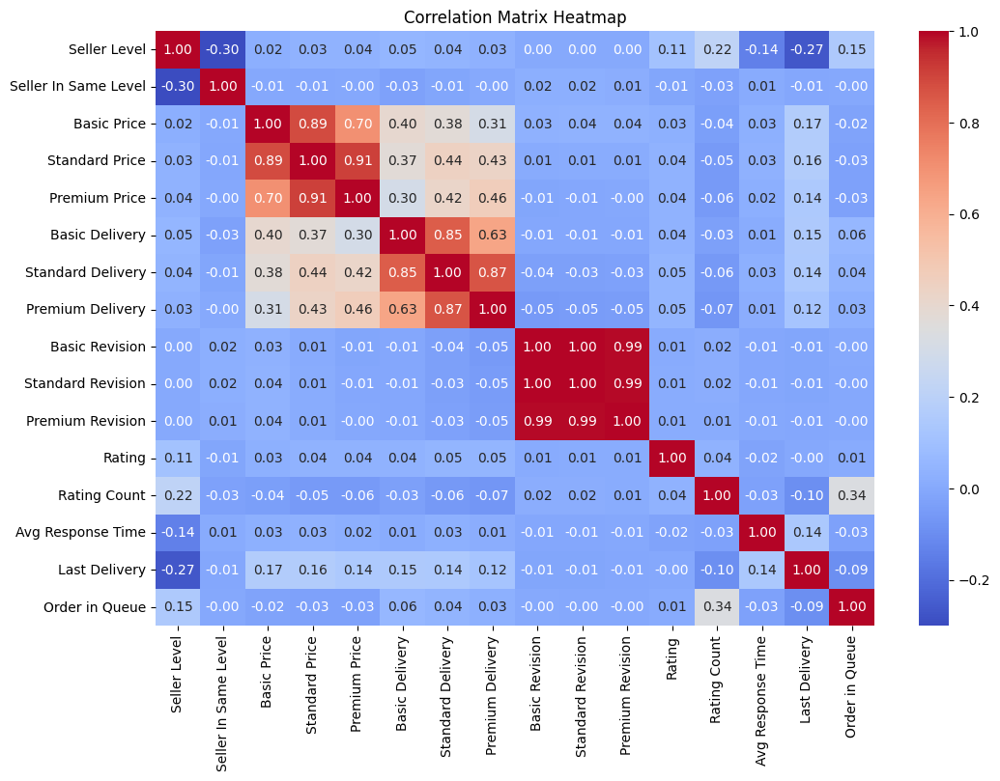

In [258]:
numeric_fields = ["Seller Level", "Seller In Same Level", "Basic Price","Standard Price","Premium Price","Basic Delivery","Standard Delivery","Premium Delivery","Basic Revision","Standard Revision","Premium Revision","Rating","Rating Count","Avg Response Time","Last Delivery","Order in Queue"]

df_selected = df[numeric_fields]

corr_matrix = df_selected.corr()

plt.figure(figsize=(12, 8))
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap="coolwarm", cbar=True)
plt.title("Correlation Matrix Heatmap")
plt.show()

In [259]:
config = Settings()

profile = ProfileReport(df, title="training data EDA", config=config)
profile.to_file("fiverr_EDA.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

c:\Users\Mahdi\AppData\Local\Programs\Python\Python312\Lib\site-packages\ydata_profiling\model\pandas\discretize_pandas.py:52: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[0 0 0 ... 0 0 0]' has dtype incompatible with int32, please explicitly cast to a compatible dtype first.
  discretized_df.loc[:, column] = self._discretize_column(
c:\Users\Mahdi\AppData\Local\Programs\Python\Python312\Lib\site-packages\ydata_profiling\model\pandas\discretize_pandas.py:52: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[0 1 0 ... 1 2 0]' has dtype incompatible with int32, please explicitly cast to a compatible dtype first.
  discretized_df.loc[:, column] = self._discretize_column(
c:\Users\Mahdi\AppData\Local\Programs\Python\Python312\Lib\site-packages\ydata_profiling\model\pandas\discretize_pandas.py:52: FutureWarning: Setting an item of incompatible dtype 

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [260]:
profile

### price fields are not balance and we need to plot without outliers .

In [261]:
def plot_within_3_sigma(df, fields):
    for field in fields:
        mean = df[field].mean()
        sigma = df[field].std()
        min_val = mean - 3 * sigma
        max_val = mean + 3 * sigma

        filtered_data = df[(df[field] >= min_val) & (df[field] <= max_val)]

        plt.figure(figsize=(10, 6))
        plt.hist(filtered_data[field], bins=30, edgecolor='black')
        plt.title(f'Histogram of {field} within mean ± 3 sigma')
        plt.xlabel(field)
        plt.ylabel('Frequency')
        plt.show()
        plt.close()

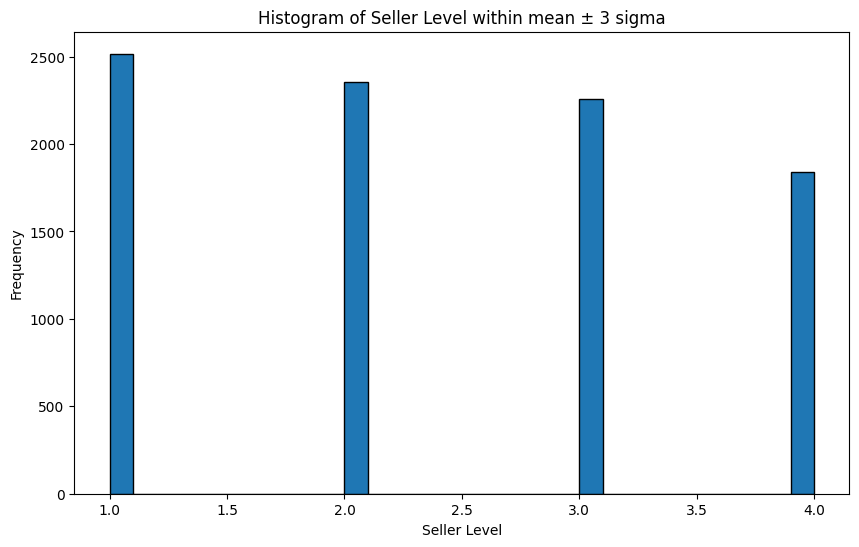

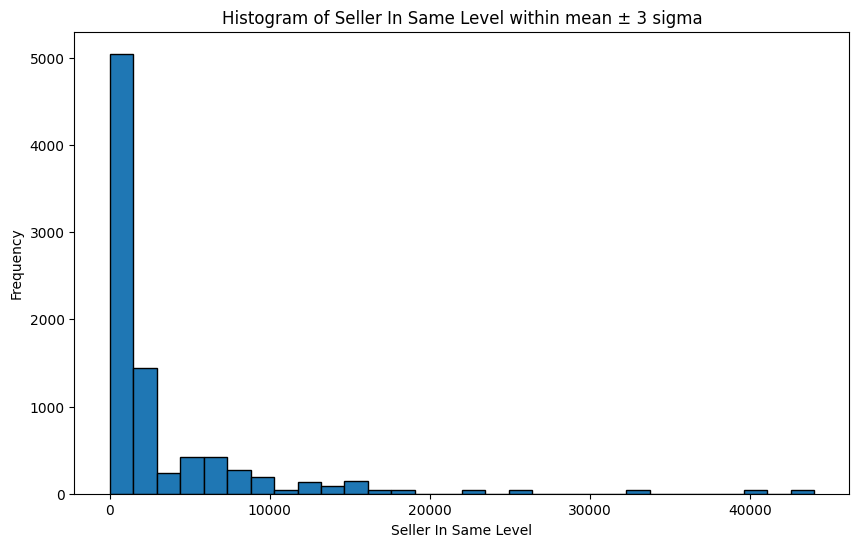

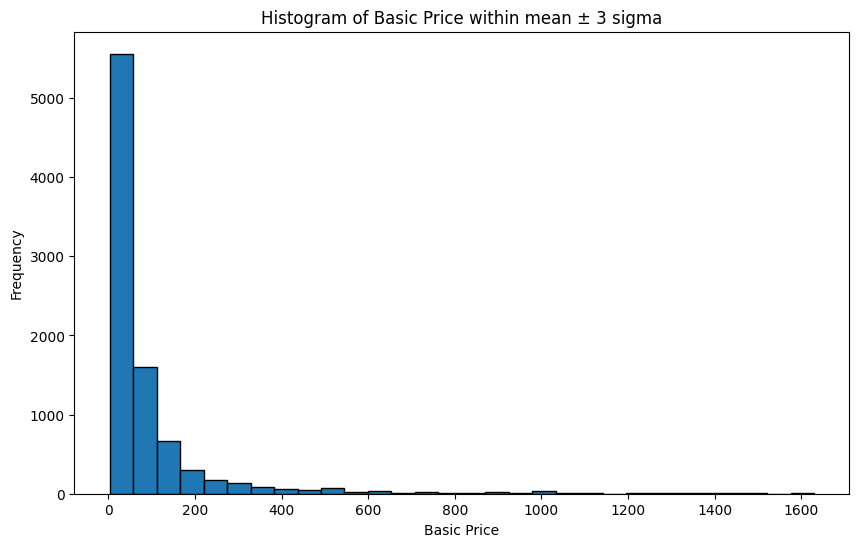

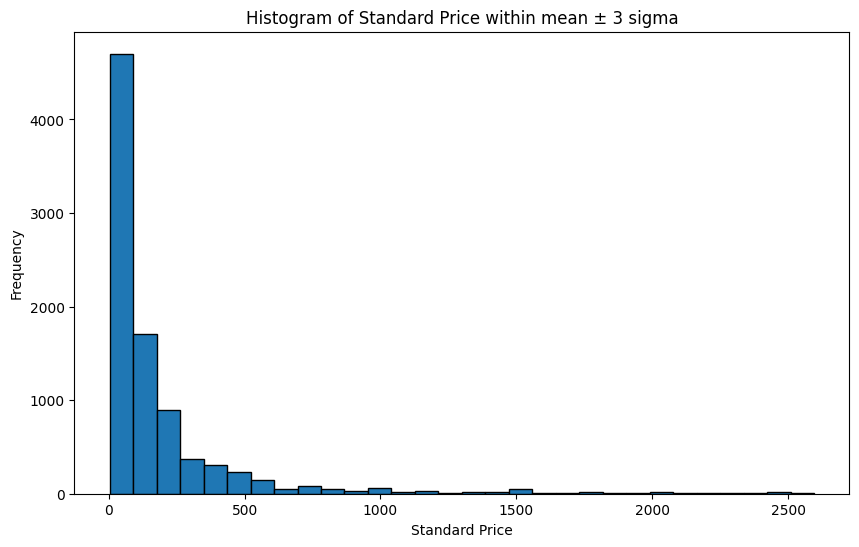

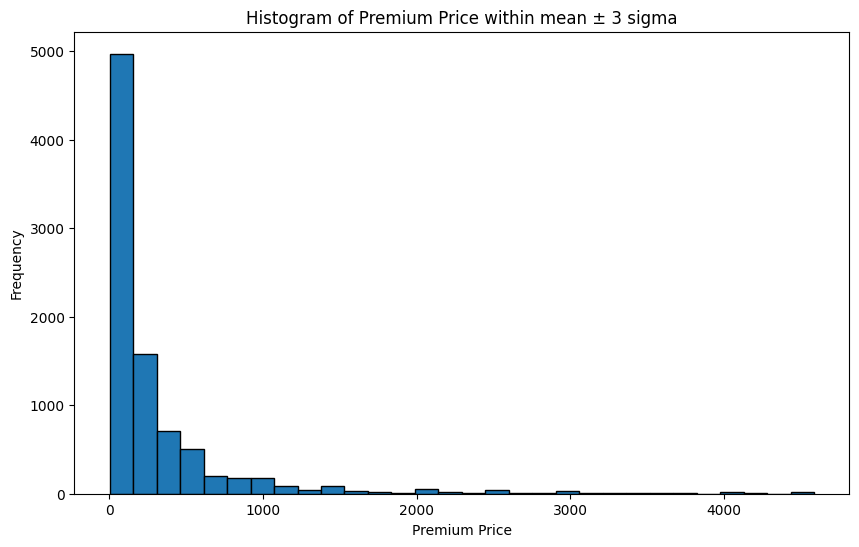

...

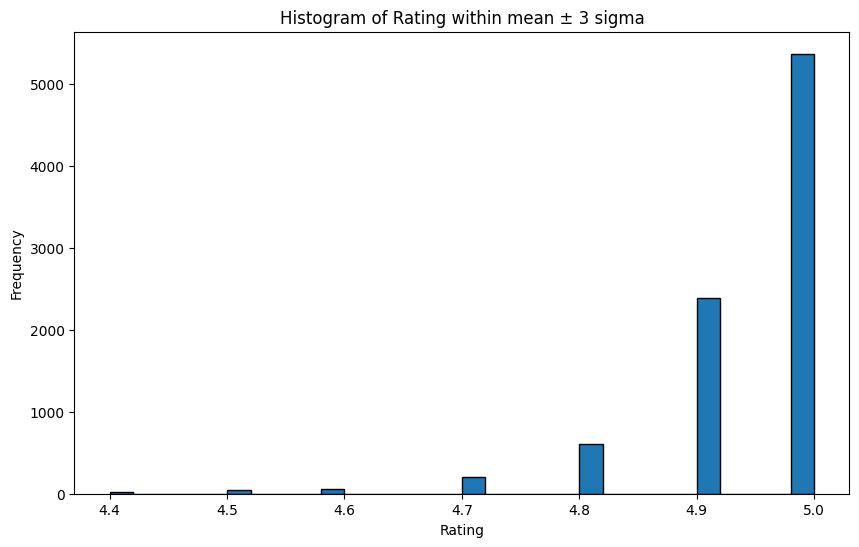

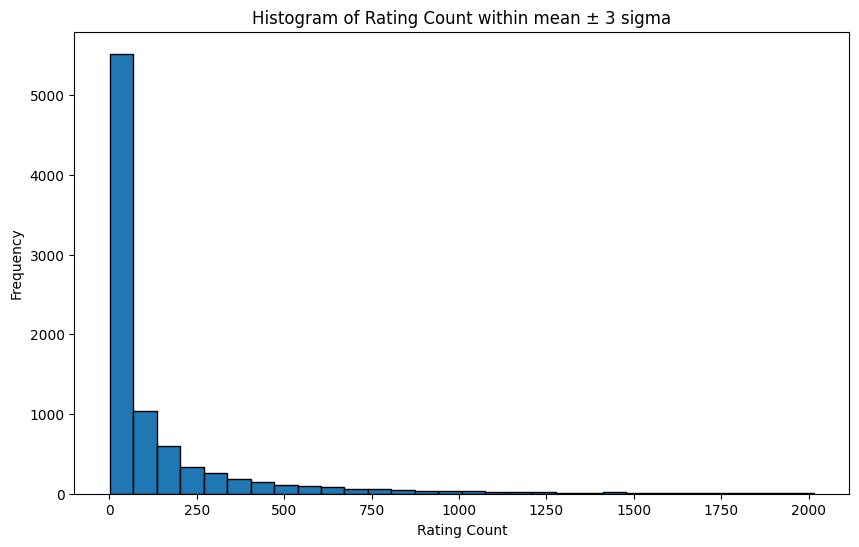

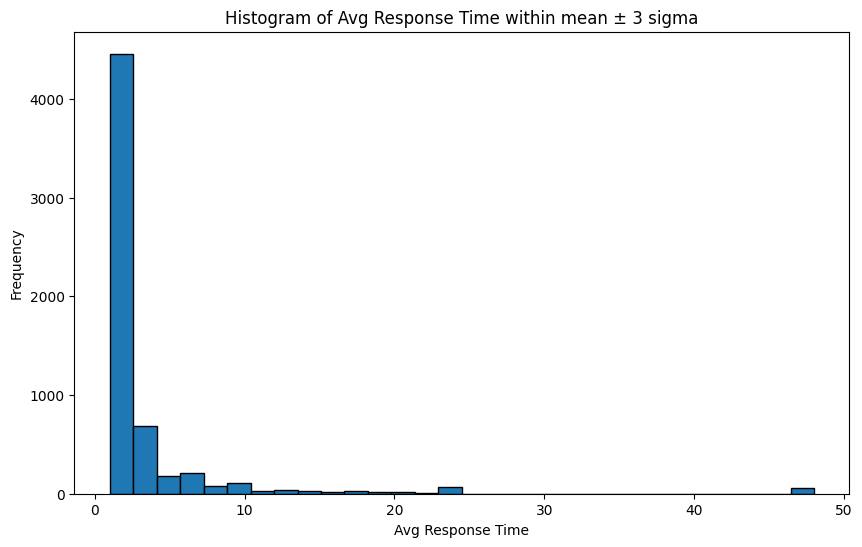

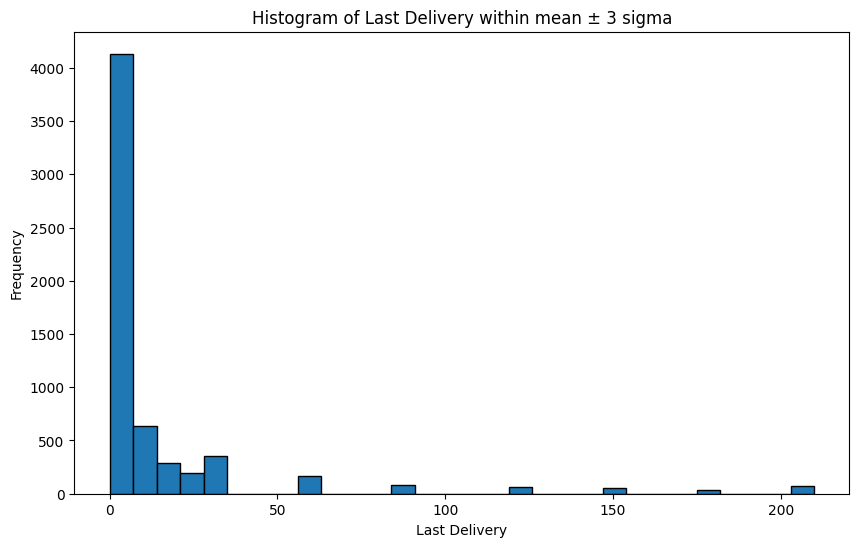

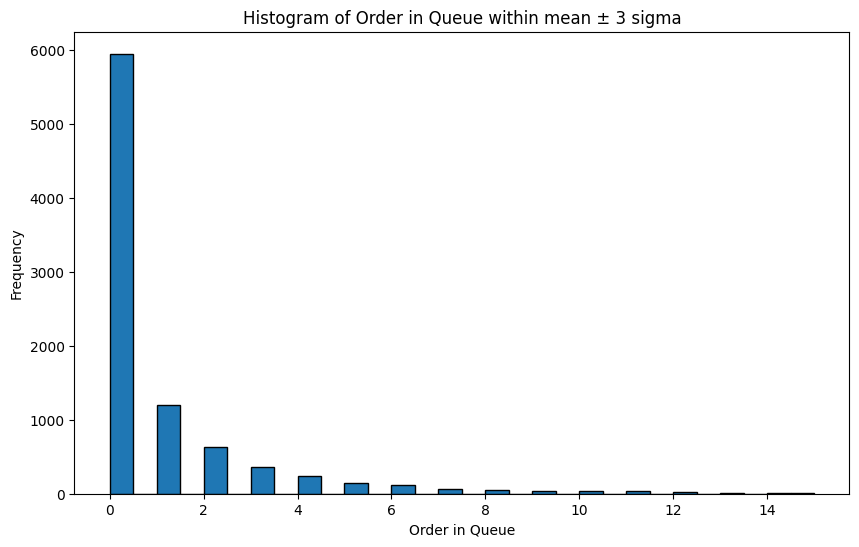

In [262]:
plot_within_3_sigma(df , numeric_fields)

In [263]:
df_single_plan = df[df['is_single_plan'] == True]
df_multi_plan = df[df['is_single_plan'] == False]

In [264]:
df_single_plan.drop(columns=['Standard Price','Premium Price','Standard Delivery','Premium Delivery','Standard Revision','Premium Revision'],axis=1,inplace=True)

C:\Users\Mahdi\AppData\Local\Temp\ipykernel_19836\4002396670.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_single_plan.drop(columns=['Standard Price','Premium Price','Standard Delivery','Premium Delivery','Standard Revision','Premium Revision'],axis=1,inplace=True)


In [265]:
df_single_plan.rename(columns={'Basic Price': 'Price','Basic Delivery':'Delivery','Basic Revision':'Revision'},inplace=True)

C:\Users\Mahdi\AppData\Local\Temp\ipykernel_19836\3074068187.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_single_plan.rename(columns={'Basic Price': 'Price','Basic Delivery':'Delivery','Basic Revision':'Revision'},inplace=True)


In [266]:
print_unique_elements(df_single_plan, ["Revision"])

Revision:
        -1 620
        1 212
        100 130
        2 100
        3 57
        5 22
        4 5
        9 3
        8 1
        6 1


In [267]:
df_single_plan.drop(columns=["Revision"],inplace=True)

C:\Users\Mahdi\AppData\Local\Temp\ipykernel_19836\358071252.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_single_plan.drop(columns=["Revision"],inplace=True)


In [268]:
print_unique_elements(df_single_plan,["Category"])

Category:
        Music & Audio 254
        Digital Marketing 206
        Data 152
        Lifestyle 122
        Business 112
        Programming & Tech 99
        Writing & Translation 76
        Graphics & Design 53
        Video & Animation 40
        Photography 37


In [269]:
gc.collect()

989296

In [270]:
single_plan_profile = ProfileReport(df_single_plan, title="single plan EDA", config=config)
single_plan_profile.to_file("fiverr_single_plan_EDA.html")

c:\Users\Mahdi\AppData\Local\Programs\Python\Python312\Lib\site-packages\ydata_profiling\utils\dataframe.py:137: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.rename(columns={"index": "df_index"}, inplace=True)


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

c:\Users\Mahdi\AppData\Local\Programs\Python\Python312\Lib\site-packages\ydata_profiling\model\pandas\discretize_pandas.py:52: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[0 0 0 ... 0 0 0]' has dtype incompatible with int32, please explicitly cast to a compatible dtype first.
  discretized_df.loc[:, column] = self._discretize_column(
c:\Users\Mahdi\AppData\Local\Programs\Python\Python312\Lib\site-packages\ydata_profiling\model\pandas\discretize_pandas.py:52: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[0 0 0 ... 1 1 2]' has dtype incompatible with int32, please explicitly cast to a compatible dtype first.
  discretized_df.loc[:, column] = self._discretize_column(
c:\Users\Mahdi\AppData\Local\Programs\Python\Python312\Lib\site-packages\ydata_profiling\model\pandas\discretize_pandas.py:52: FutureWarning: Setting an item of incompatible dtype 

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [271]:
gc.collect()
multy_plan_profile = ProfileReport(df_multi_plan, title="single plan EDA", config=config)
multy_plan_profile.to_file("multy_plan_EDA.html")

c:\Users\Mahdi\AppData\Local\Programs\Python\Python312\Lib\site-packages\ydata_profiling\utils\dataframe.py:137: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.rename(columns={"index": "df_index"}, inplace=True)


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

c:\Users\Mahdi\AppData\Local\Programs\Python\Python312\Lib\site-packages\ydata_profiling\model\pandas\discretize_pandas.py:52: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[0 0 0 ... 0 0 0]' has dtype incompatible with int32, please explicitly cast to a compatible dtype first.
  discretized_df.loc[:, column] = self._discretize_column(
c:\Users\Mahdi\AppData\Local\Programs\Python\Python312\Lib\site-packages\ydata_profiling\model\pandas\discretize_pandas.py:52: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[0 1 0 ... 1 1 0]' has dtype incompatible with int32, please explicitly cast to a compatible dtype first.
  discretized_df.loc[:, column] = self._discretize_column(
c:\Users\Mahdi\AppData\Local\Programs\Python\Python312\Lib\site-packages\ydata_profiling\model\pandas\discretize_pandas.py:52: FutureWarning: Setting an item of incompatible dtype 

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

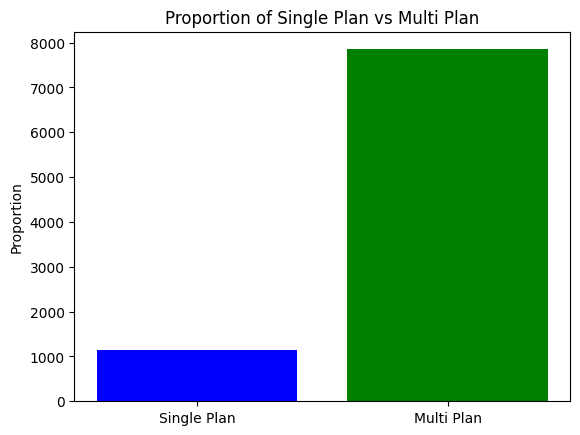

In [272]:
single_counts = df_single_plan.count()
multi_counts = df_multi_plan.count()
labels = ["Single Plan", "Multi Plan"]

plt.bar(labels[0], single_counts, color="blue", label="Single Plan")
plt.bar(labels[1], multi_counts, color="green", label="Multi Plan")

plt.title("Proportion of Single Plan vs Multi Plan")
plt.ylabel("Proportion")
plt.show()

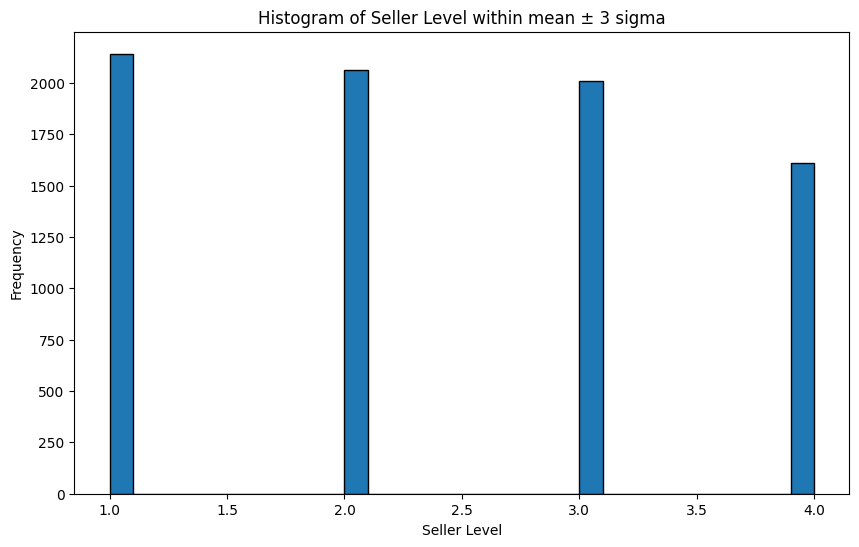

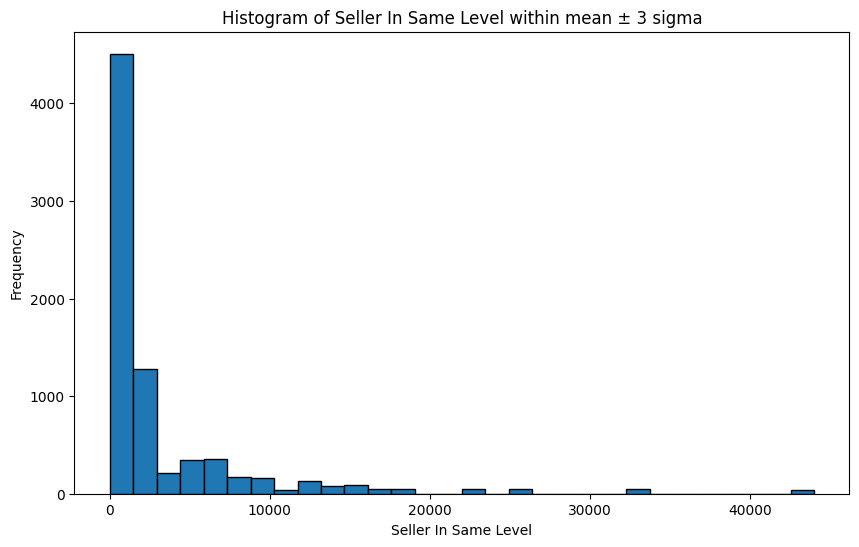

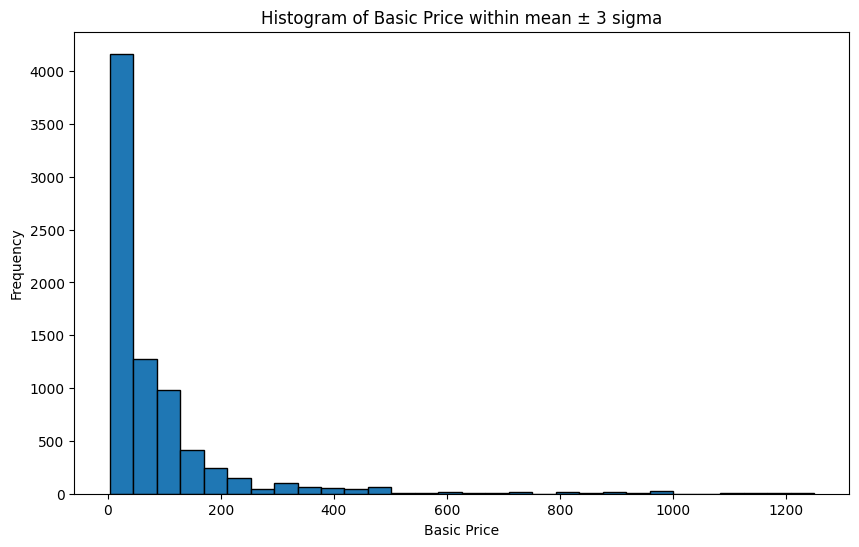

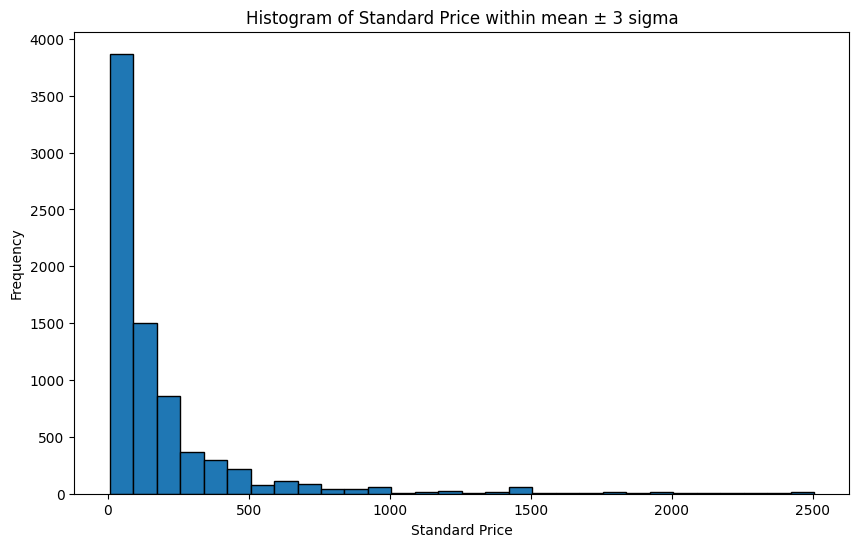

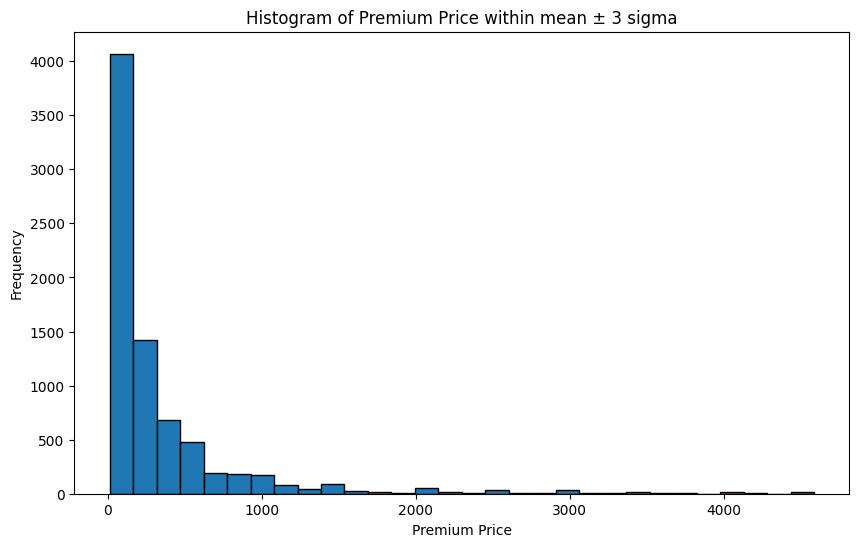

...

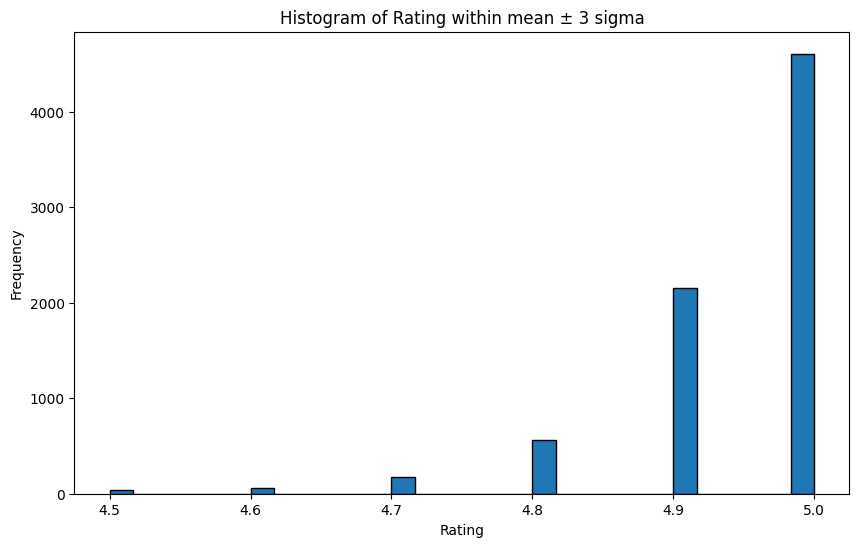

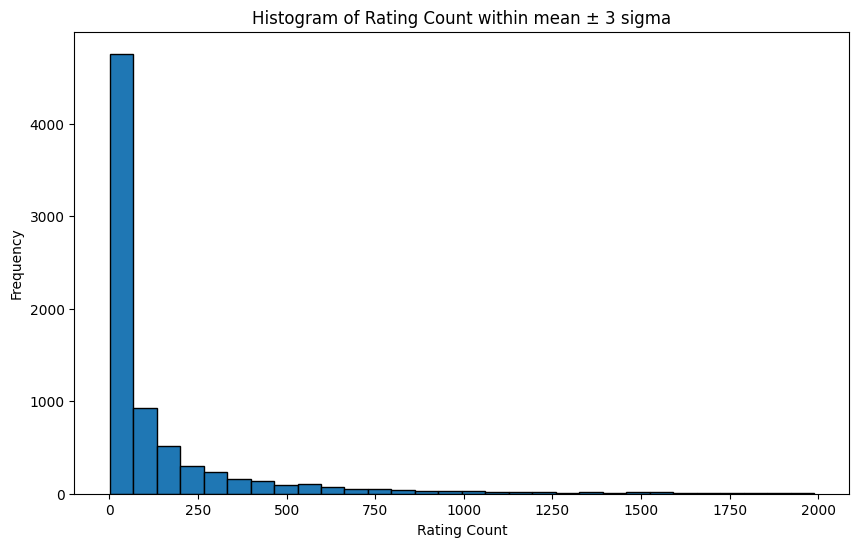

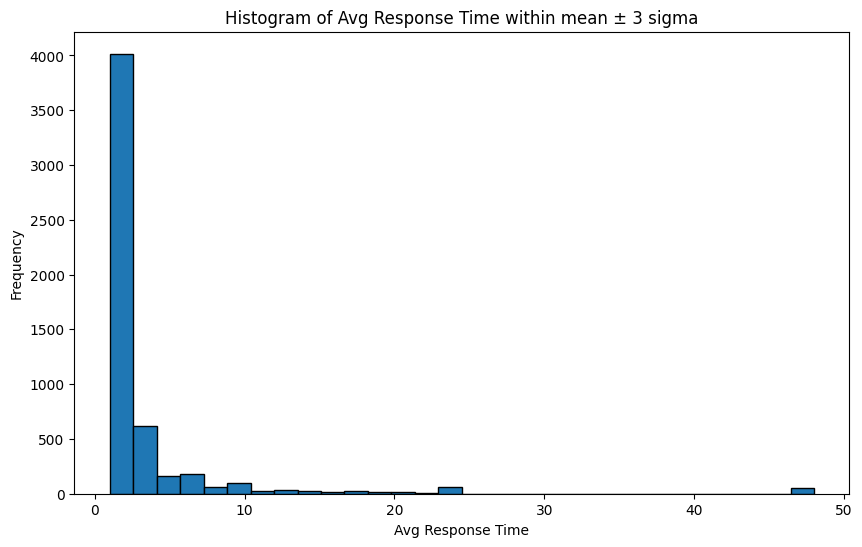

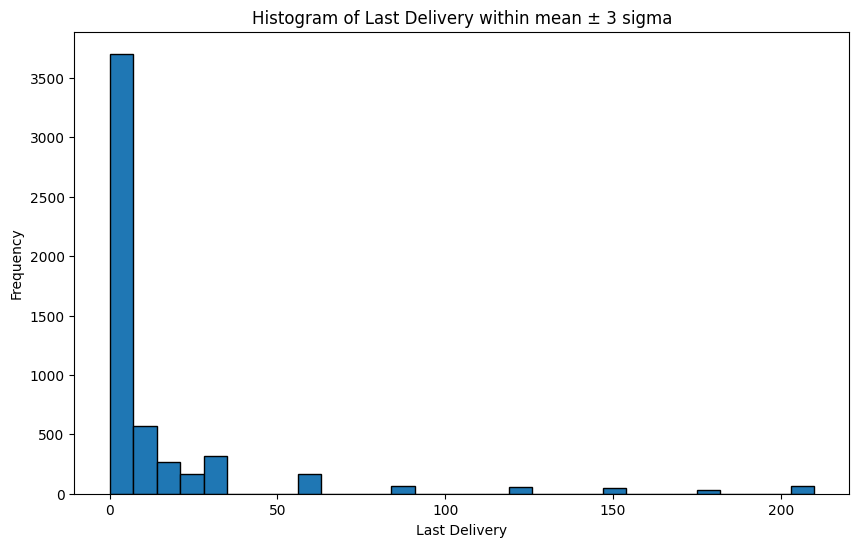

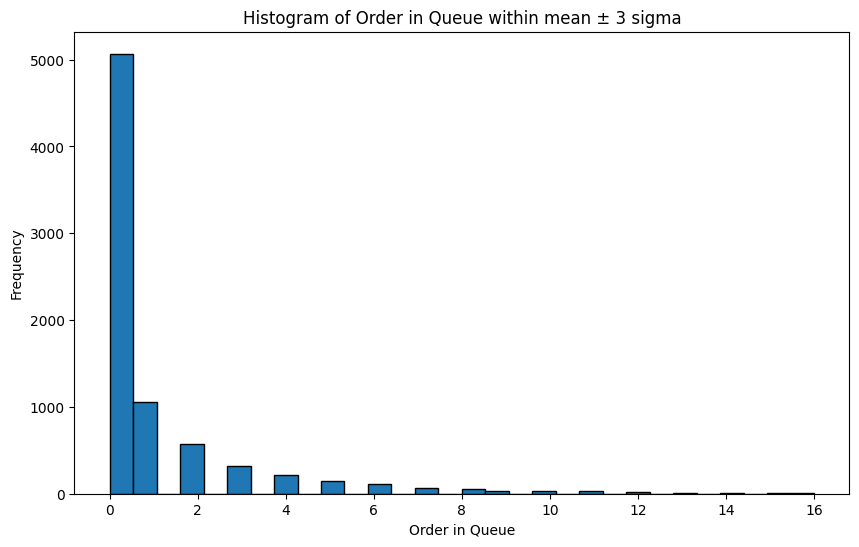

In [273]:
plot_within_3_sigma(df_multi_plan , numeric_fields)

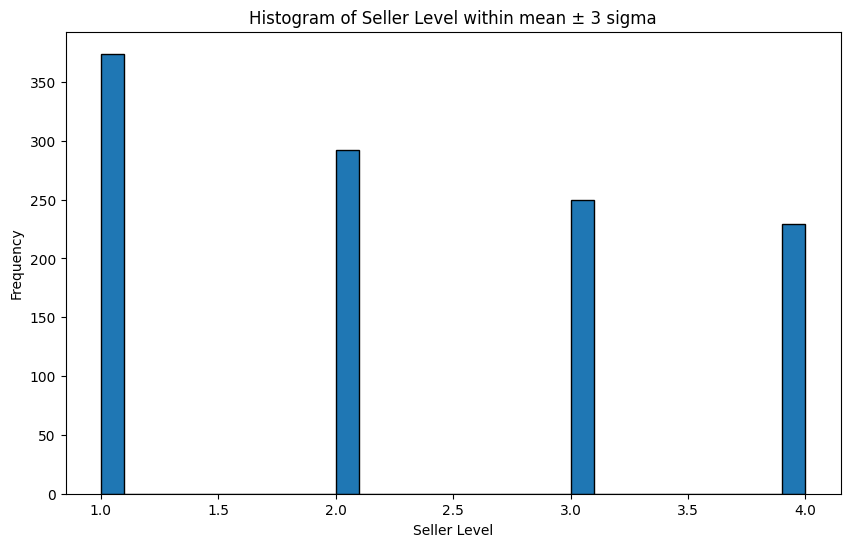

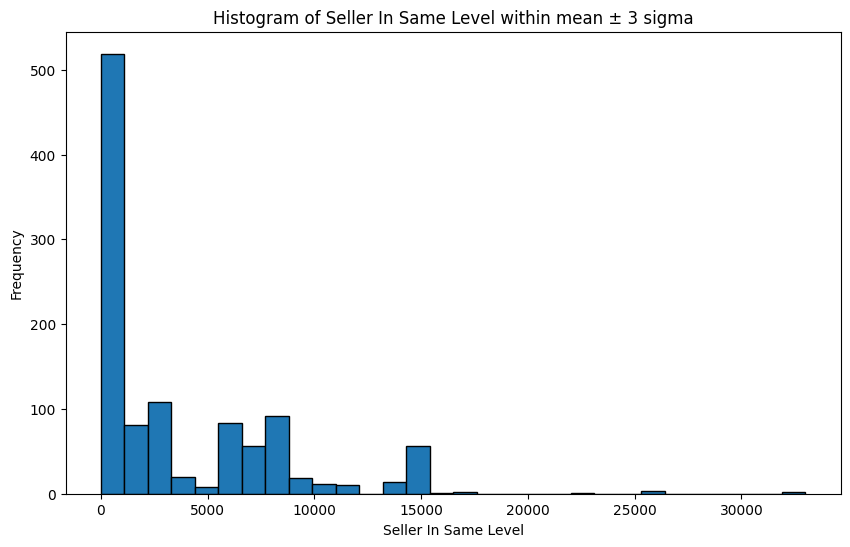

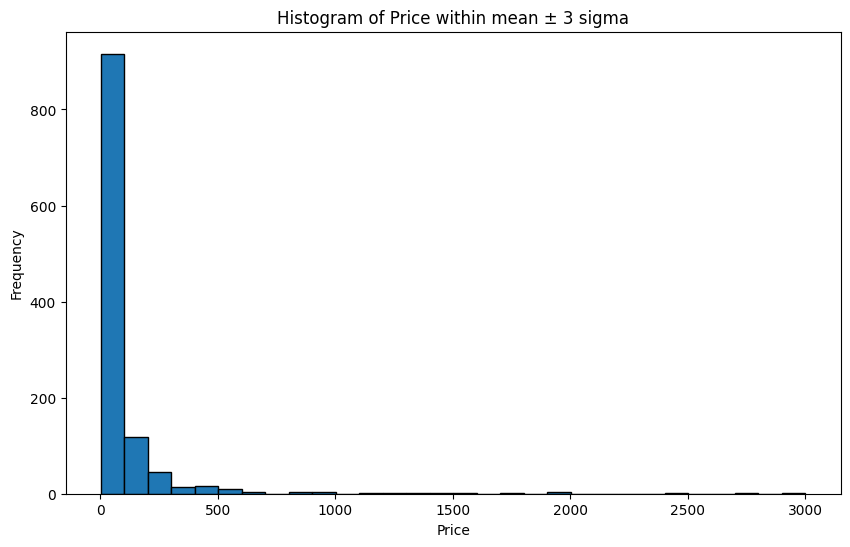

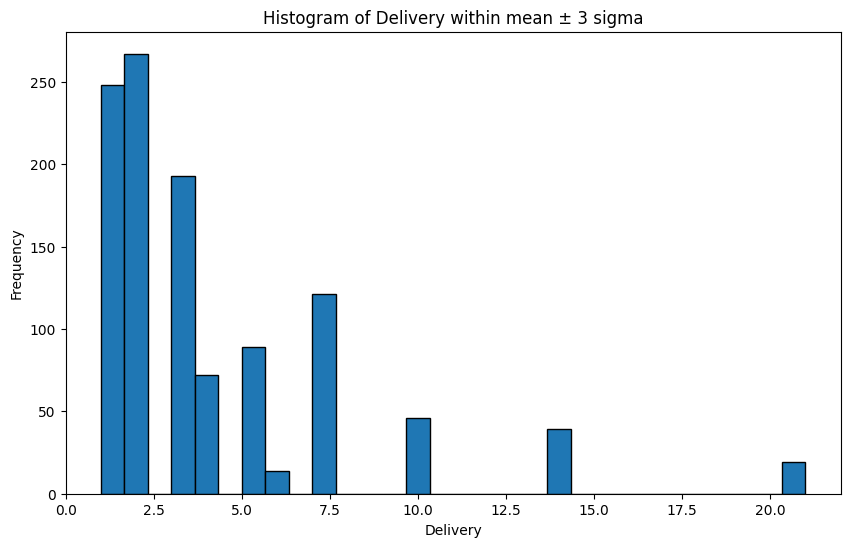

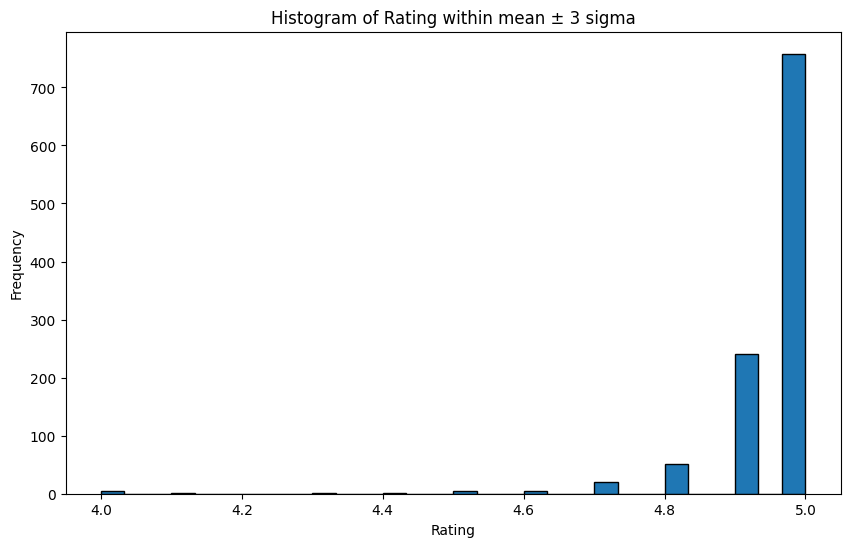

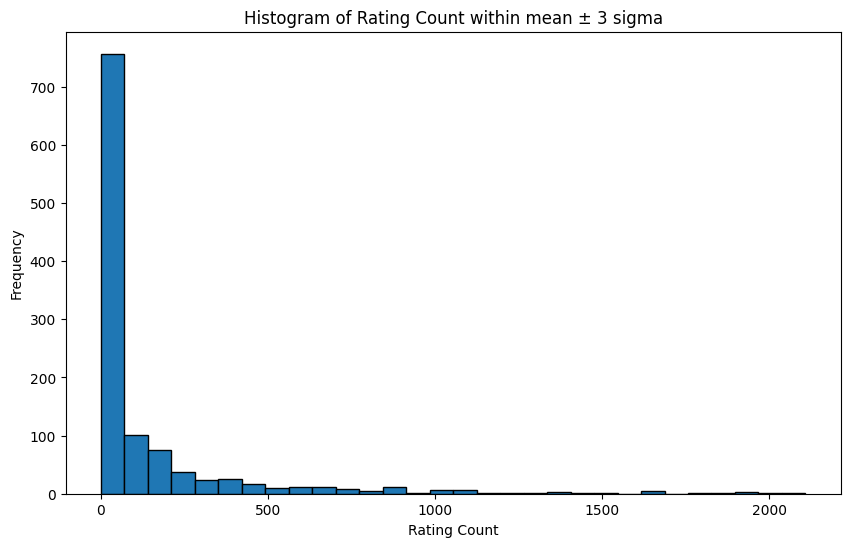

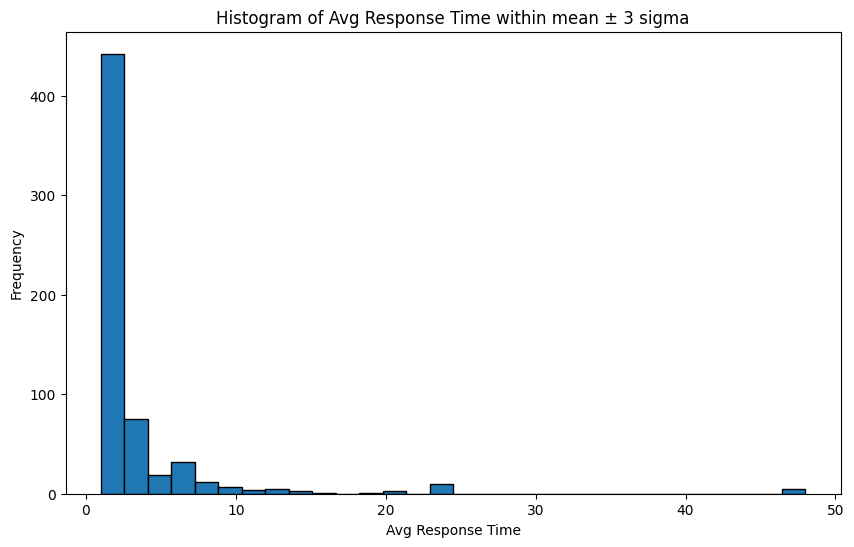

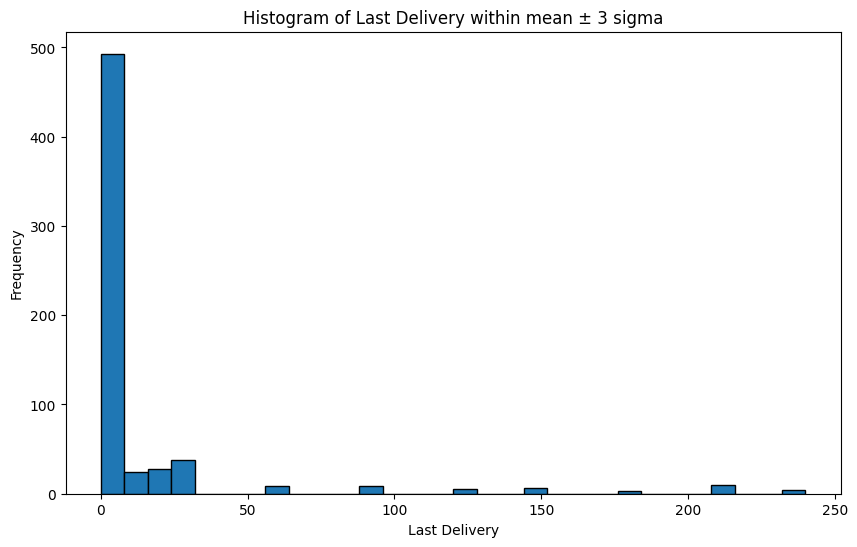

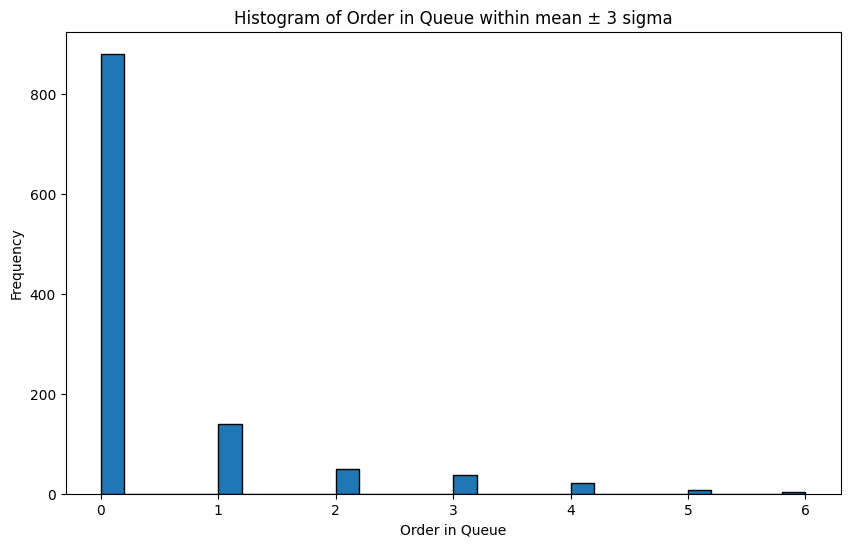

In [274]:
plot_within_3_sigma(df_single_plan,['Seller Level','Seller In Same Level','Price','Delivery','Rating','Rating Count','Avg Response Time','Last Delivery','Order in Queue'])

2.0
Shapiro-Wilk Test for level 2.0: ShapiroResult(statistic=0.3168167735178631, pvalue=4.7328959219921357e-66)


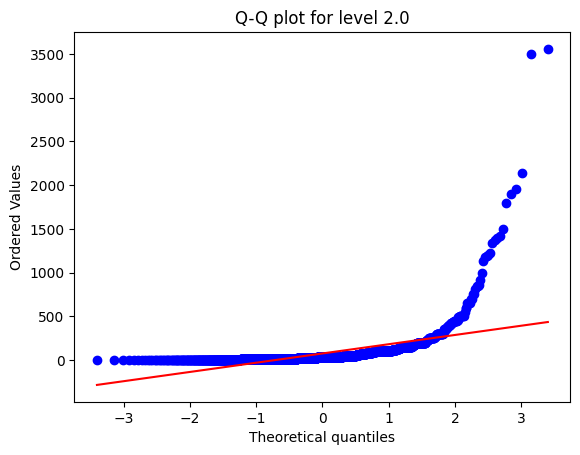

3.0
Shapiro-Wilk Test for level 3.0: ShapiroResult(statistic=0.3613880639512711, pvalue=3.429983482582121e-64)


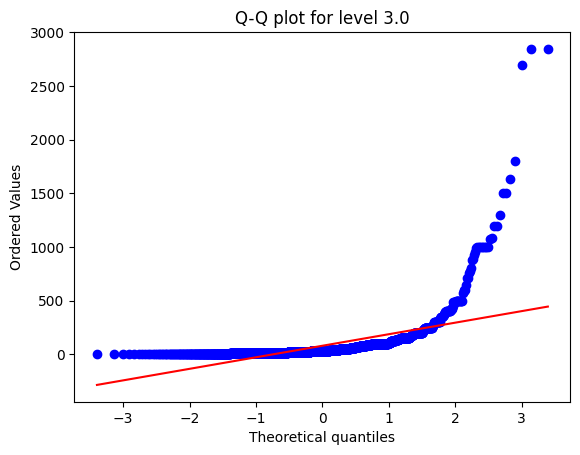

1.0
Shapiro-Wilk Test for level 1.0: ShapiroResult(statistic=0.22035715640166376, pvalue=1.9175127267307957e-69)


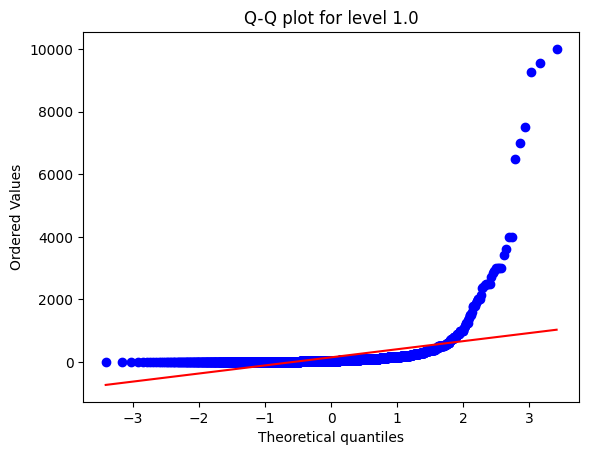

4.0
Shapiro-Wilk Test for level 4.0: ShapiroResult(statistic=0.29641329229772384, pvalue=2.8460340616917467e-61)


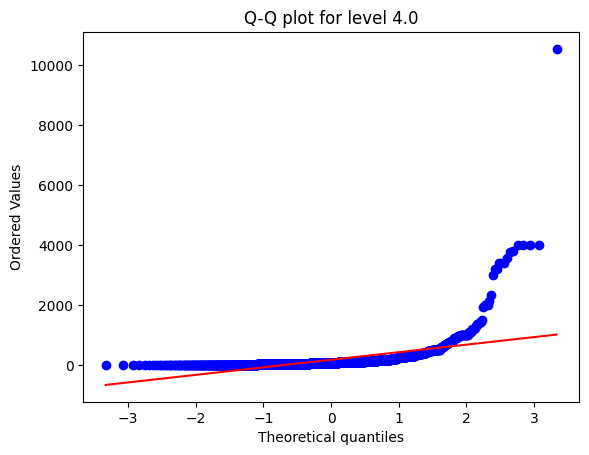

In [275]:
unique_levels = df_multi_plan['Seller Level'].dropna().unique()
for level in unique_levels:
    print(level)
    print(f"Shapiro-Wilk Test for level {level}:", stats.shapiro(df_multi_plan['Basic Price'][df_multi_plan['Seller Level'] == level]))

    stats.probplot(df_multi_plan['Basic Price'][df_multi_plan['Seller Level'] == level], plot=plt)
    plt.title(f"Q-Q plot for level {level}")
    plt.show()

we are not allowed to use anova here so we use Kruskal-Wallis test instead .

In [276]:
def plot_average_prices(df, group_by_columns, price_columns, height, orientation = 'horizontal',sort = True , original_order=None):
    fig, axs = plt.subplots(1, len(price_columns), figsize=(15, height))

    for i, price_column in enumerate(price_columns):
        average_prices = df.groupby(group_by_columns)[price_column].mean()
        if sort:
            average_prices = average_prices.sort_values(ascending=True)
        if not sort and original_order :
            average_prices = average_prices.reindex(original_order)
        if orientation == 'horizontal':
            average_prices.plot(kind='barh', color='skyblue', ax=axs[i])
            axs[i].set_xlabel(price_column)
        else:
            average_prices.plot(kind='bar', color='skyblue', ax=axs[i])
            axs[i].set_ylabel(price_column)

        axs[i].set_title(f'Average {price_column} for Each {group_by_columns}')
        axs[i].grid(axis='x' if orientation == 'horizontal' else 'y')

    plt.tight_layout()
    plt.show()

In [277]:
H, pvalue = stats.kruskal(df_multi_plan['Basic Price'][df_multi_plan['Seller Level'] == 1],
                          df_multi_plan['Basic Price'][df_multi_plan['Seller Level'] == 2],
                          df_multi_plan['Basic Price'][df_multi_plan['Seller Level'] == 3],
                          df_multi_plan['Basic Price'][df_multi_plan['Seller Level'] == 4])

print('H-statistic:', H)
print('P-value:', pvalue)

H-statistic: 367.22675790669155
P-value: 2.7752862087649116e-79


based on Kruskal-Wallis test result we can say that there is a meaningfull relation between the basic price and seller level .

In [278]:
H, pvalue = stats.kruskal(df_multi_plan['Standard Price'][df_multi_plan['Seller Level'] == 1],
                          df_multi_plan['Standard Price'][df_multi_plan['Seller Level'] == 2],
                          df_multi_plan['Standard Price'][df_multi_plan['Seller Level'] == 3],
                          df_multi_plan['Standard Price'][df_multi_plan['Seller Level'] == 4])

print('H-statistic:', H)
print('P-value:', pvalue)

H-statistic: 331.7117391607228
P-value: 1.3593613422806536e-71


based on Kruskal-Wallis test result we can say that there is a meaningfull relation between the standard price and seller level .

In [279]:
H, pvalue = stats.kruskal(df_multi_plan['Premium Price'][df_multi_plan['Seller Level'] == 1],
                          df_multi_plan['Premium Price'][df_multi_plan['Seller Level'] == 2],
                          df_multi_plan['Premium Price'][df_multi_plan['Seller Level'] == 3],
                          df_multi_plan['Premium Price'][df_multi_plan['Seller Level'] == 4])

print('H-statistic:', H)
print('P-value:', pvalue)

H-statistic: 273.8907192405872
P-value: 4.443158123517203e-59


based on Kruskal-Wallis test result we can say that there is a meaningfull relation between the premium price and seller level .

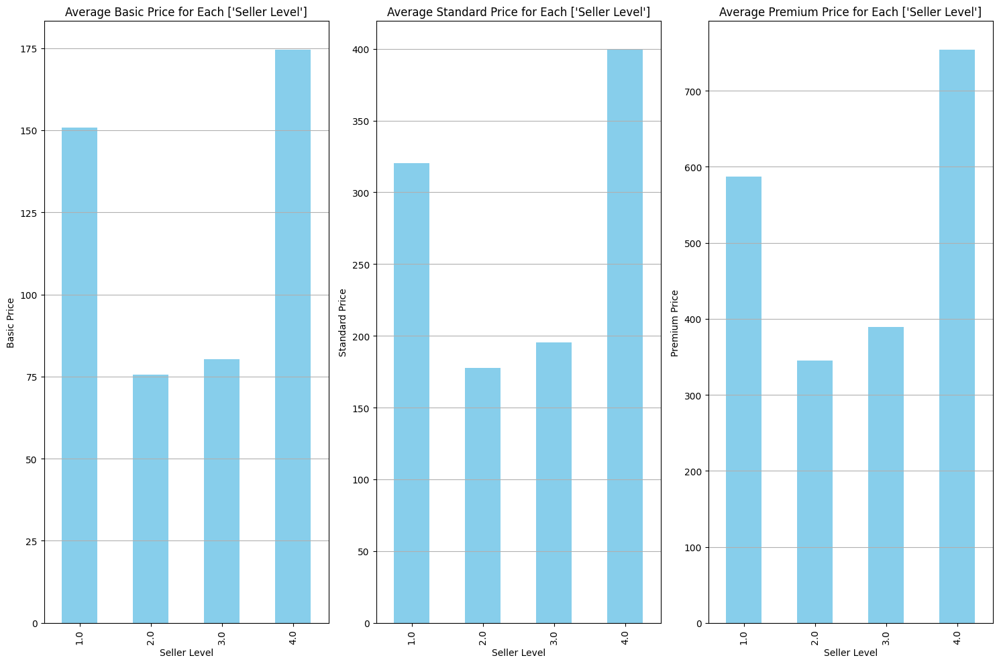

In [280]:
plot_average_prices(df_multi_plan, ["Seller Level"], ["Basic Price","Standard Price","Premium Price"], 10,'vertical',False)

Shapiro-Wilk Test for level 2.0: ShapiroResult(statistic=0.5197261710925554, pvalue=1.579207122837021e-59)


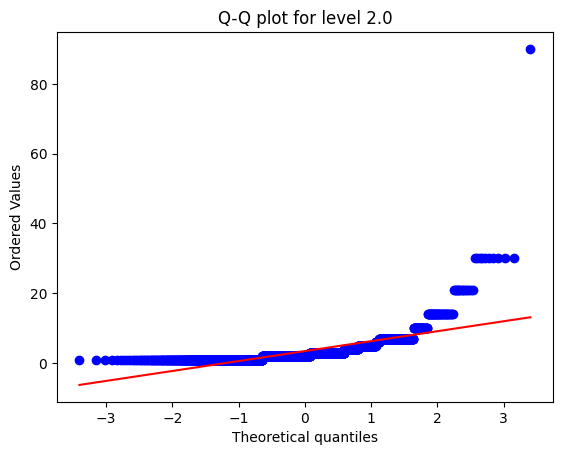

Shapiro-Wilk Test for level 3.0: ShapiroResult(statistic=0.572145288883704, pvalue=6.372136169589398e-57)


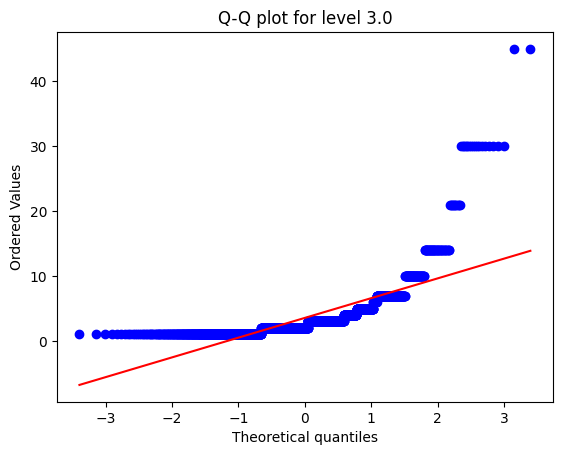

Shapiro-Wilk Test for level 1.0: ShapiroResult(statistic=0.4801333149378395, pvalue=9.228512813121429e-62)


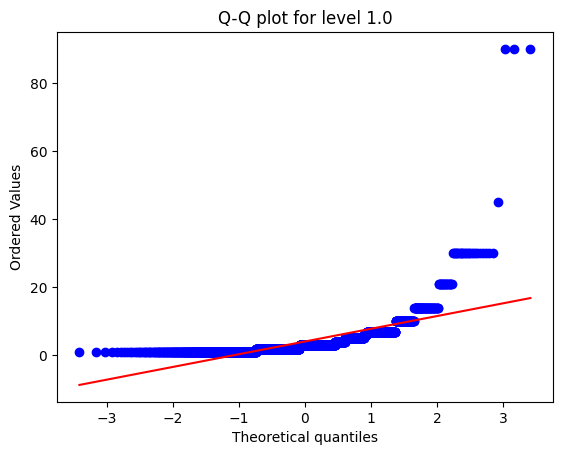

Shapiro-Wilk Test for level 4.0: ShapiroResult(statistic=0.6197680817822571, pvalue=1.2097012472973647e-50)


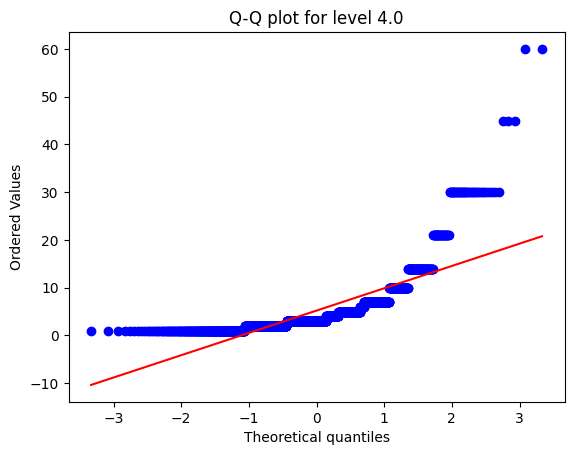

In [283]:
unique_levels = df_multi_plan['Seller Level'].dropna().unique()
for level in unique_levels:
    print(f"Shapiro-Wilk Test for level {level}:", stats.shapiro(df_multi_plan['Basic Delivery'][df_multi_plan['Seller Level'] == level]))

    stats.probplot(df_multi_plan['Basic Delivery'][df_multi_plan['Seller Level'] == level], plot=plt)
    plt.title(f"Q-Q plot for level {level}")
    plt.show()

still cant use anova

In [284]:
basic_H, basic_pvalue = stats.kruskal(df_multi_plan['Basic Delivery'][df_multi_plan['Seller Level'] == 1],
                          df_multi_plan['Basic Delivery'][df_multi_plan['Seller Level'] == 2],
                          df_multi_plan['Basic Delivery'][df_multi_plan['Seller Level'] == 3],
                          df_multi_plan['Basic Delivery'][df_multi_plan['Seller Level'] == 4])

standard_H, standard_pvalue = stats.kruskal(df_multi_plan['Standard Delivery'][df_multi_plan['Seller Level'] == 1],
                          df_multi_plan['Standard Delivery'][df_multi_plan['Seller Level'] == 2],
                          df_multi_plan['Standard Delivery'][df_multi_plan['Seller Level'] == 3],
                          df_multi_plan['Standard Delivery'][df_multi_plan['Seller Level'] == 4])

premium_H, premium_pvalue = stats.kruskal(df_multi_plan['Premium Delivery'][df_multi_plan['Seller Level'] == 1],
                          df_multi_plan['Premium Delivery'][df_multi_plan['Seller Level'] == 2],
                          df_multi_plan['Premium Delivery'][df_multi_plan['Seller Level'] == 3],
                          df_multi_plan['Premium Delivery'][df_multi_plan['Seller Level'] == 4])

print('basic H-statistic:', basic_H)
print('basic P-value:', basic_pvalue)
print('standard H-statistic:', standard_H)
print('standard P-value:', standard_pvalue)
print('premium H-statistic:', premium_H)
print('premium P-value:', premium_pvalue)

basic H-statistic: 214.85677720263448
basic P-value: 2.596962125031872e-46
standard H-statistic: 145.72411691291612
standard P-value: 2.203261339706896e-31
premium H-statistic: 78.46285749144465
premium P-value: 6.557102981787335e-17


based on Kruskal-Wallis test results we can say that there is a meaningfull relation between the all deliveries and seller level .

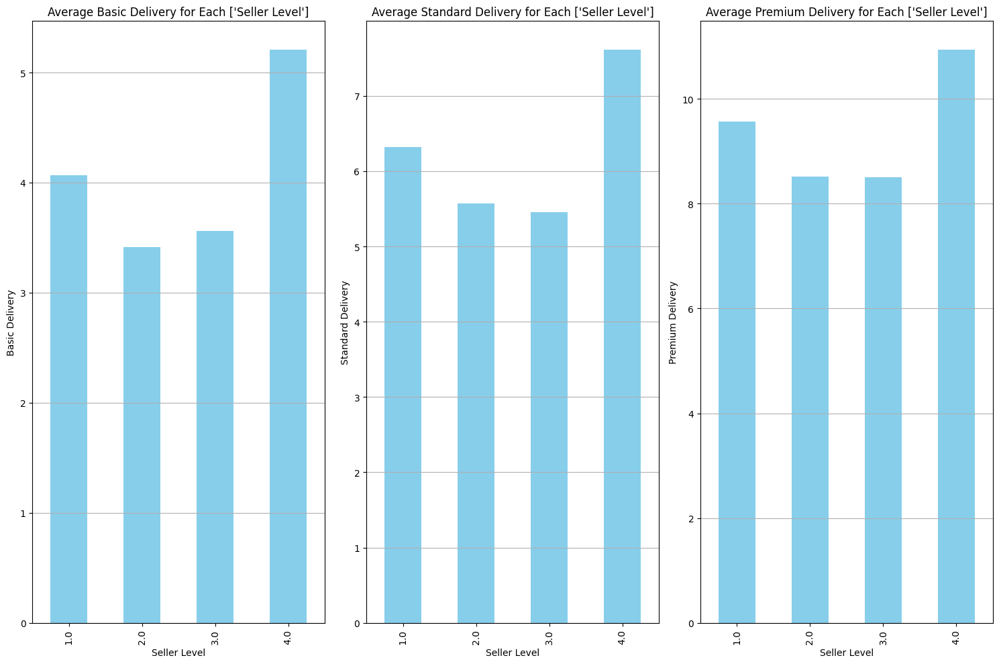

In [285]:
plot_average_prices(df_multi_plan, ["Seller Level"], ["Basic Delivery","Standard Delivery","Premium Delivery"], 10,'vertical',False)

Shapiro-Wilk Test for level 2.0: ShapiroResult(statistic=0.2044912938408323, pvalue=5.618771971595392e-69)


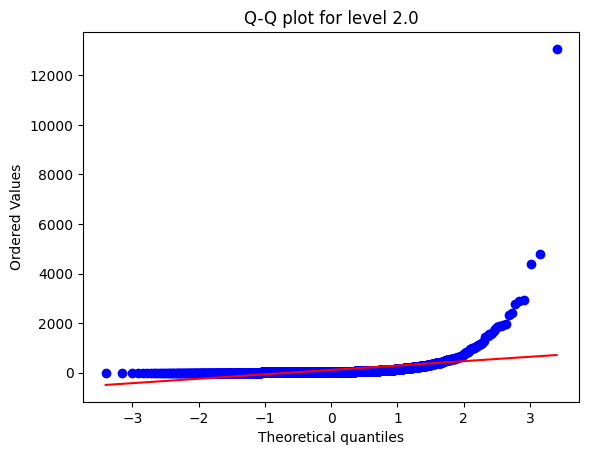

Shapiro-Wilk Test for level 3.0: ShapiroResult(statistic=0.2871791442406241, pvalue=2.894046974980315e-66)


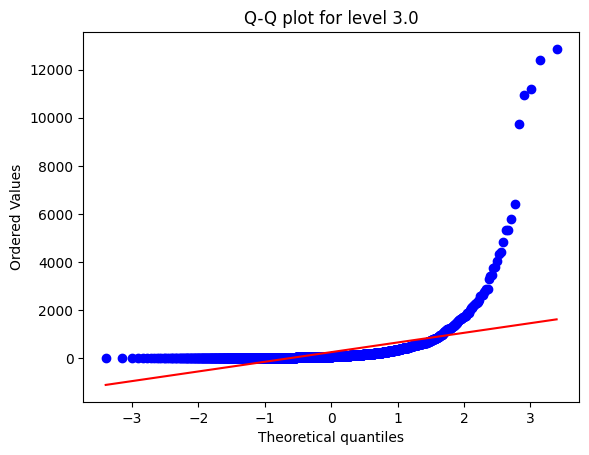

Shapiro-Wilk Test for level 1.0: ShapiroResult(statistic=0.3553382133654074, pvalue=8.792937101566425e-66)


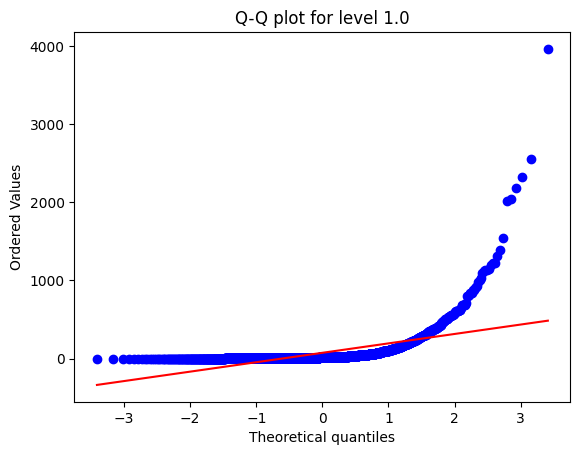

Shapiro-Wilk Test for level 4.0: ShapiroResult(statistic=0.5296939479695757, pvalue=3.3794757417669544e-54)


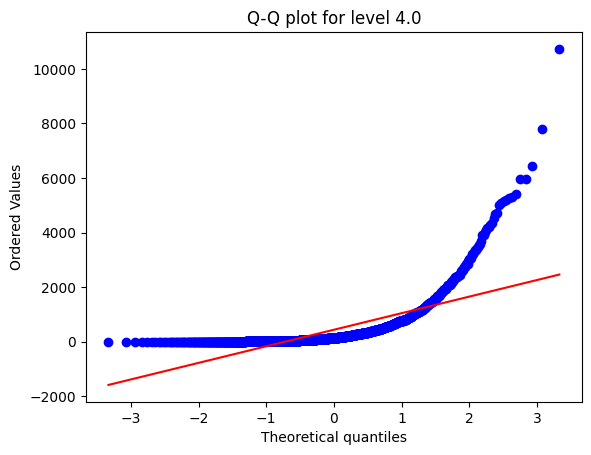

In [287]:
unique_levels = df_multi_plan['Seller Level'].dropna().unique()
for level in unique_levels:
    print(f"Shapiro-Wilk Test for level {level}:", stats.shapiro(df_multi_plan['Rating Count'][df_multi_plan['Seller Level'] == level]))

    stats.probplot(df_multi_plan['Rating Count'][df_multi_plan['Seller Level'] == level], plot=plt)
    plt.title(f"Q-Q plot for level {level}")
    plt.show()

In [288]:
H, pvalue = stats.kruskal(df_multi_plan['Rating Count'][df_multi_plan['Seller Level'] == 1],
                          df_multi_plan['Rating Count'][df_multi_plan['Seller Level'] == 2],
                          df_multi_plan['Rating Count'][df_multi_plan['Seller Level'] == 3],
                          df_multi_plan['Rating Count'][df_multi_plan['Seller Level'] == 4])

print('H-statistic:', H)
print('P-value:', pvalue)

H-statistic: 1251.331266331229
P-value: 5.343685131992199e-271


so there is also a meaningful relationship between Rating Count and seller level.

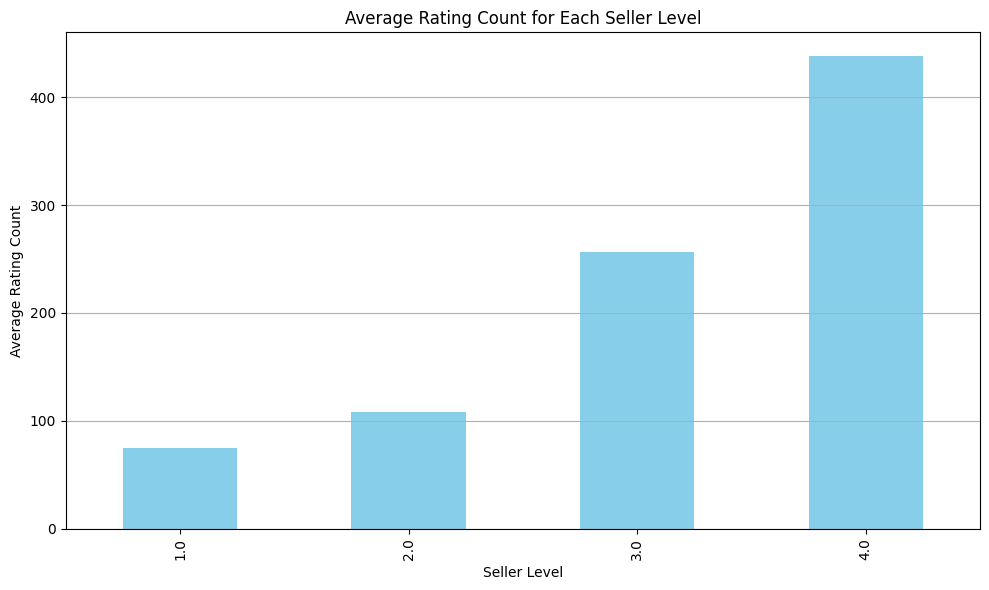

In [289]:
average_counts = df_multi_plan.groupby("Seller Level")["Rating Count"].mean()
plt.figure(figsize=(10, 6))
average_counts.plot(kind="bar", color="skyblue")
plt.xlabel("Seller Level")
plt.ylabel("Average Rating Count")
plt.title("Average Rating Count for Each Seller Level")
plt.grid(axis="y")
plt.tight_layout()
plt.show()

In [290]:
W, p = stats.shapiro(df['Avg Response Time'])
print(f'Shapiro-Wilk test statistic: {W}, p-value: {p}')
W, p = stats.shapiro(df['Rating Count'])
print(f'Shapiro-Wilk test statistic: {W}, p-value: {p}')

Shapiro-Wilk test statistic: nan, p-value: 1.0
Shapiro-Wilk test statistic: 0.3195673617213429, p-value: 2.1072926339324688e-102


C:\Users\Mahdi\AppData\Local\Temp\ipykernel_19836\375691215.py:1: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 9001.
  W, p = stats.shapiro(df['Avg Response Time'])
C:\Users\Mahdi\AppData\Local\Temp\ipykernel_19836\375691215.py:3: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 9001.
  W, p = stats.shapiro(df['Rating Count'])


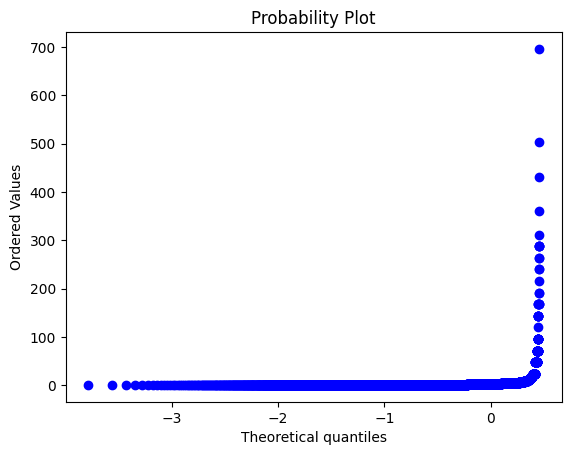

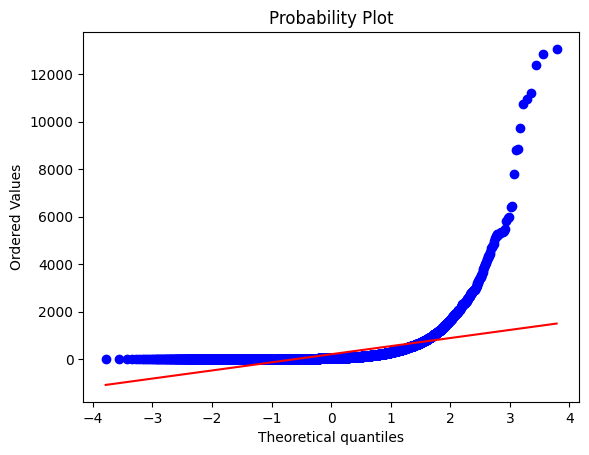

In [291]:
stats.probplot(df['Avg Response Time'], plot=plt)
plt.show()
stats.probplot(df['Rating Count'], plot=plt)
plt.show()

In [292]:
df_copy = df.copy()

df_copy.dropna(subset=['Avg Response Time', 'Rating Count'], inplace=True)

x = df_copy['Avg Response Time']
y = df_copy['Rating Count']

pearson_coef, p_value = stats.pearsonr(x, y)
print("Pearson's correlation coefficient:", pearson_coef)

Pearson's correlation coefficient: -0.030329061253334753


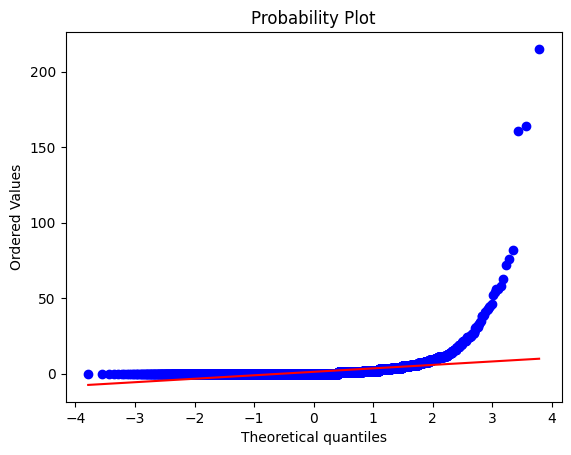

In [293]:
stats.probplot(df['Order in Queue'], plot=plt)
plt.show()

In [294]:
df_copy = df.copy()

df_copy.dropna(subset=['Avg Response Time', 'Order in Queue'], inplace=True)

x = df_copy['Avg Response Time']
y = df_copy['Order in Queue']

spearman_coef, p_value = stats.spearmanr(x, y)
print("Spearman's correlation coefficient:", spearman_coef)

Spearman's correlation coefficient: -0.04792291435269604


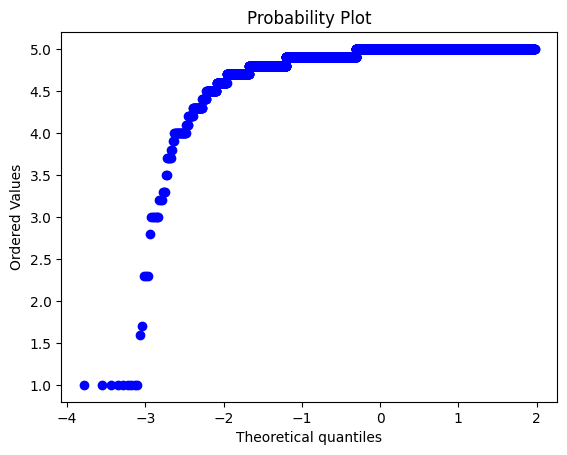

In [295]:
stats.probplot(df['Rating'], plot=plt)
plt.show()

In [296]:
df_copy = df.copy()

df_copy.dropna(subset=['Avg Response Time', 'Rating'], inplace=True)

x = df_copy['Avg Response Time']
y = df_copy['Rating']

spearman_coef, p_value = stats.spearmanr(x, y)
print("Spearman's correlation coefficient:", spearman_coef)

Spearman's correlation coefficient: 0.08280423617579441


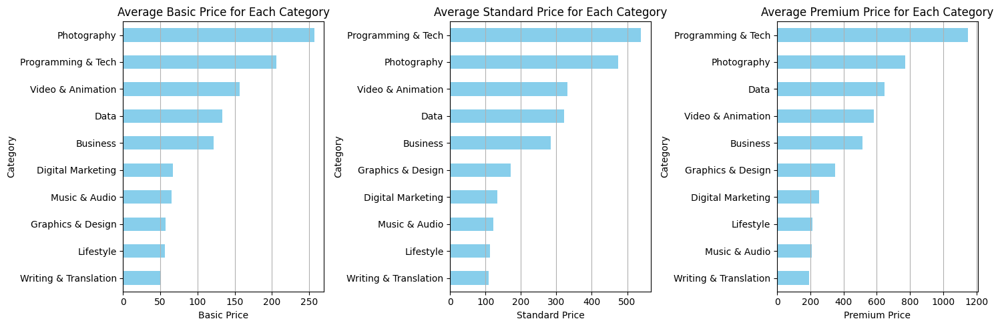

In [297]:
plot_average_prices(df_multi_plan, "Category", ["Basic Price", "Standard Price", "Premium Price"],5)


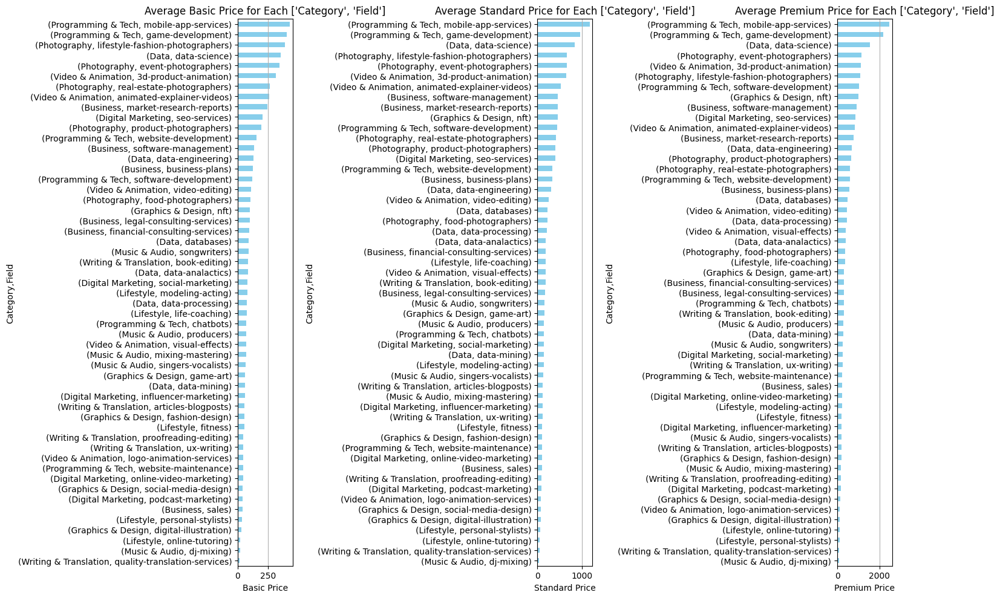

In [298]:
plot_average_prices(df_multi_plan, ["Category","Field"], ["Basic Price", "Standard Price", "Premium Price"],10)

In [299]:
def calculate_outlier_percentage(series):
    q1 = series.quantile(0.25)
    q3 = series.quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outliers_count = ((series < lower_bound) | (series > upper_bound)).sum()
    total_count = len(series)
    outliers_percentage = (outliers_count / total_count) * 100
    return outliers_percentage

In [300]:
def plot_boxplot(df, x, y):
    plt.figure(figsize=(15, 6))
    sns.boxplot(y=y, x=x, data=df, orient="h")
    plt.title(f"{x} By {y} Box plot")
    plt.ylabel(y)
    plt.xlabel(x)
    plt.show()

    outliers_percentage = df.groupby(y)[x].apply(calculate_outlier_percentage)
    return outliers_percentage

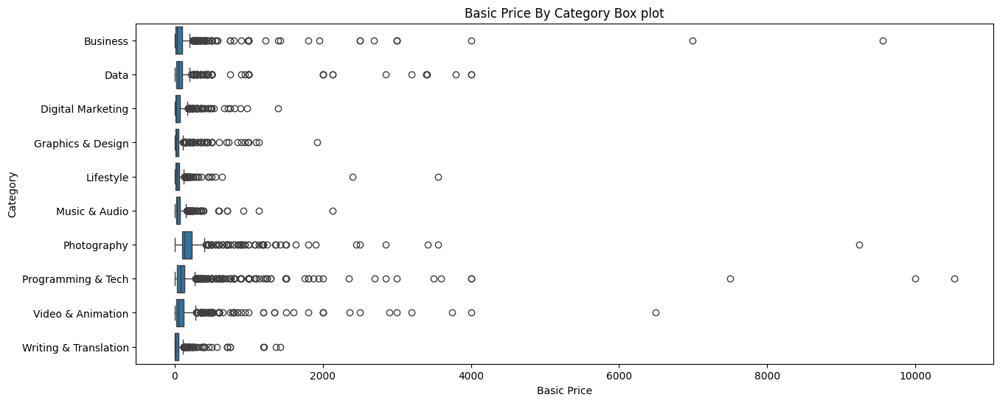

Category
Business                  8.717949
Data                      9.963986
Digital Marketing         9.151414
Graphics & Design         9.964830
Lifestyle                 7.090103
Music & Audio             6.666667
Photography              11.188811
Programming & Tech       13.946281
Video & Animation        12.043796
Writing & Translation     9.151194
Name: Basic Price, dtype: float64


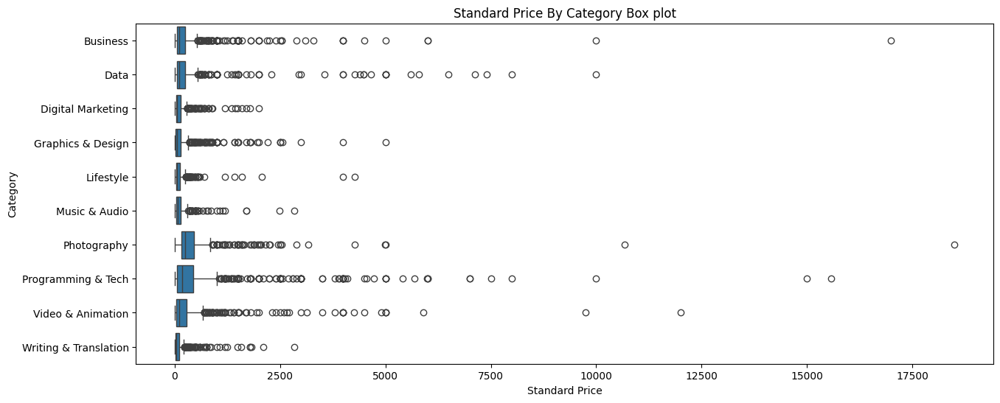

Category
Business                  9.846154
Data                      8.883553
Digital Marketing        10.648918
Graphics & Design        11.254396
Lifestyle                 7.976366
Music & Audio             5.408805
Photography               9.440559
Programming & Tech       11.466942
Video & Animation         9.367397
Writing & Translation     9.549072
Name: Standard Price, dtype: float64


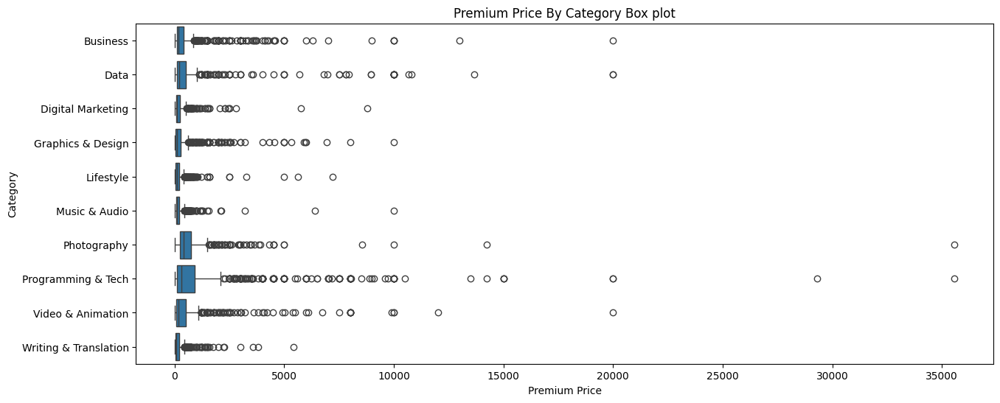

Category
Business                 12.000000
Data                      8.883553
Digital Marketing         9.317804
Graphics & Design        11.840563
Lifestyle                 9.748892
Music & Audio             9.433962
Photography               9.090909
Programming & Tech       13.016529
Video & Animation         9.854015
Writing & Translation     9.681698
Name: Premium Price, dtype: float64


In [301]:
print(plot_boxplot(df_multi_plan,"Basic Price","Category"))
print(plot_boxplot(df_multi_plan,"Standard Price","Category"))
print(plot_boxplot(df_multi_plan,"Premium Price","Category"))

In [302]:
def cat_plot(f1, f2, df, target):
    plt.figure(figsize=(15, 6))
    sns.catplot(x=f1, y=target, hue=f2, data=df, kind="bar", height=6, aspect=2)
    plt.title(f"{target} Distribution by {f1} and {f2}")
    plt.xticks(rotation=45)
    plt.show()

<Figure size 1500x600 with 0 Axes>

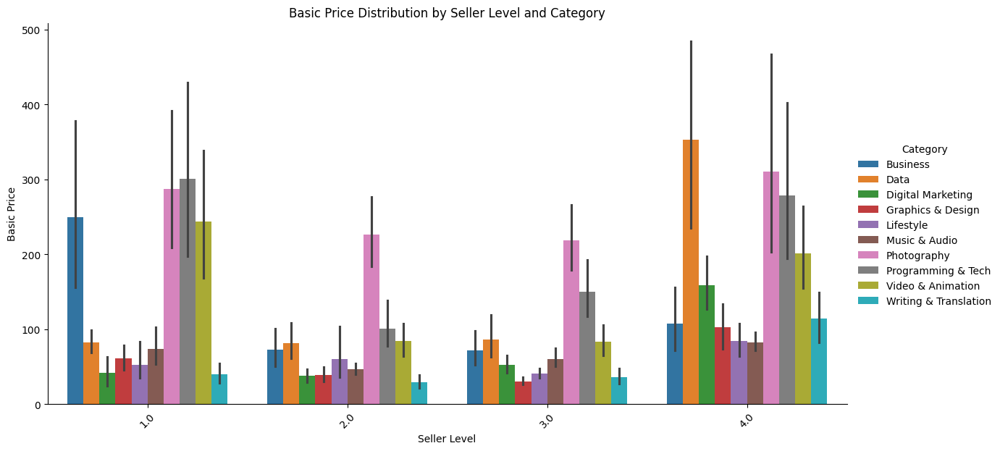

In [303]:
cat_plot('Seller Level', 'Category', df_multi_plan, 'Basic Price')

<Figure size 1500x600 with 0 Axes>

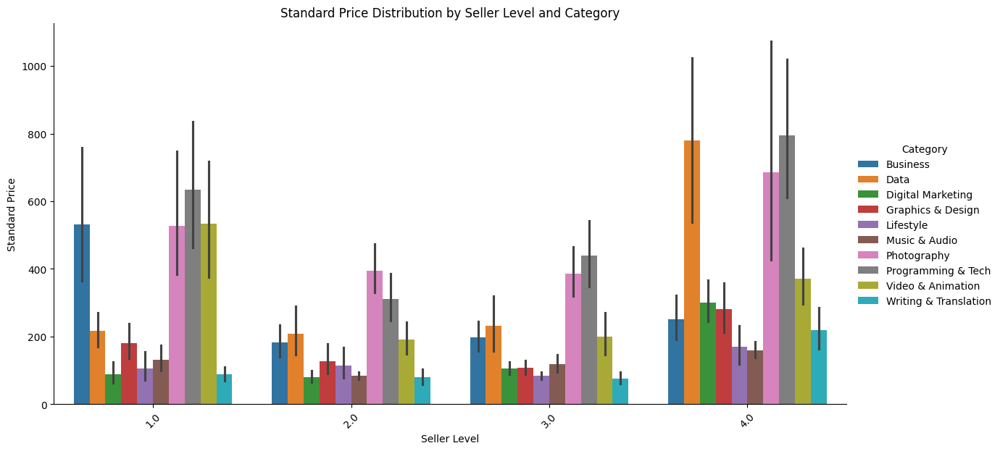

In [304]:
cat_plot("Seller Level", "Category", df_multi_plan, "Standard Price")

<Figure size 1500x600 with 0 Axes>

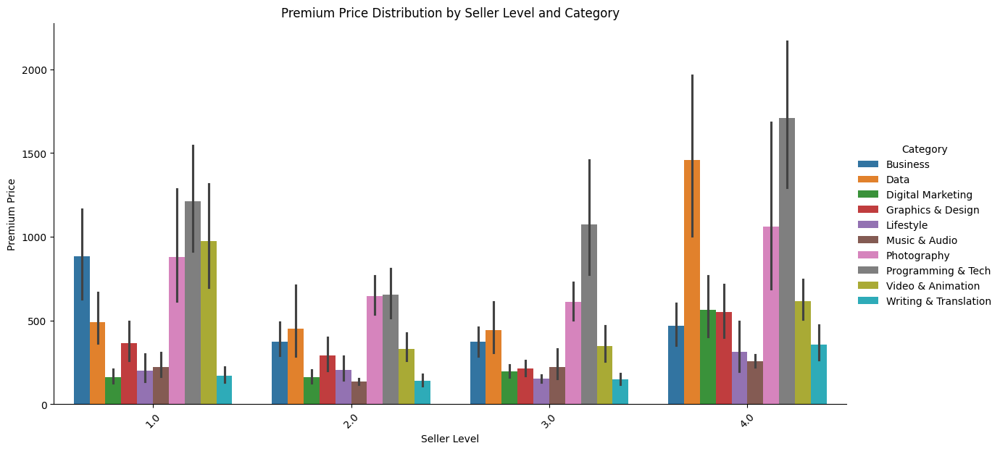

In [305]:
cat_plot("Seller Level", "Category", df_multi_plan, "Premium Price")

<Figure size 1500x600 with 0 Axes>

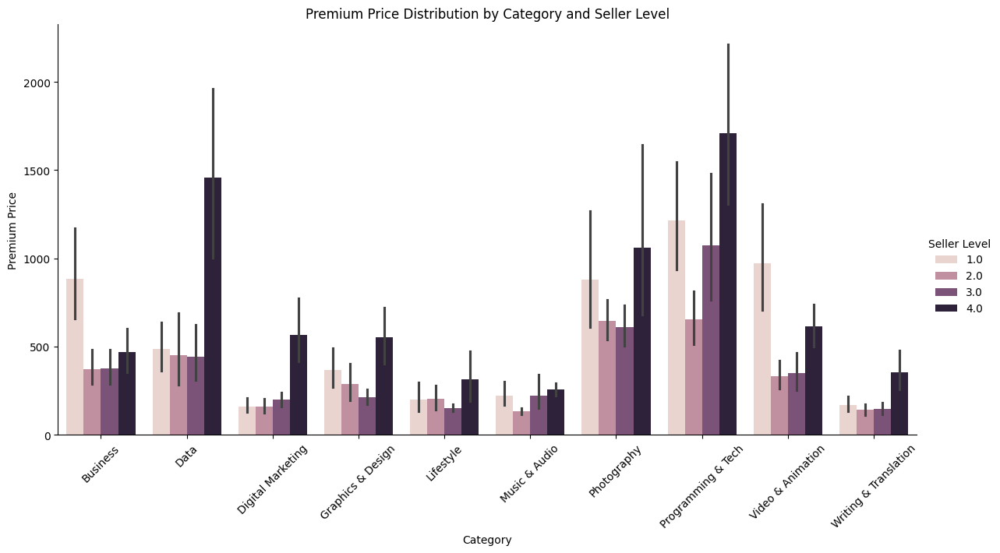

In [306]:
cat_plot("Category", "Seller Level", df_multi_plan, "Premium Price")

In [307]:
import math
def cat_plot_by_category(df, field_col, target_col, plots_per_row=3):
    categories = df["Category"].unique()
    num_categories = len(categories)
    num_rows = math.ceil(num_categories / plots_per_row)

    fig, axes = plt.subplots(num_rows, plots_per_row, figsize=(8 * plots_per_row, 6 * num_rows))
    axes = axes.flatten()

    for i, category in enumerate(categories):
        ax = axes[i]
        cat_df = df[df["Category"] == category]
        sns.barplot(
            x=field_col, y=target_col, hue=field_col, data=cat_df, ax=ax, dodge=False
        )
        ax.set_title(f"{target_col} Distribution for {category} and Field")
        ax.set_ylabel(target_col)
        ax.set_xlabel("")
        ax.set_xticklabels([])
        ax.legend(title=field_col)

    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    plt.tight_layout()
    plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that 

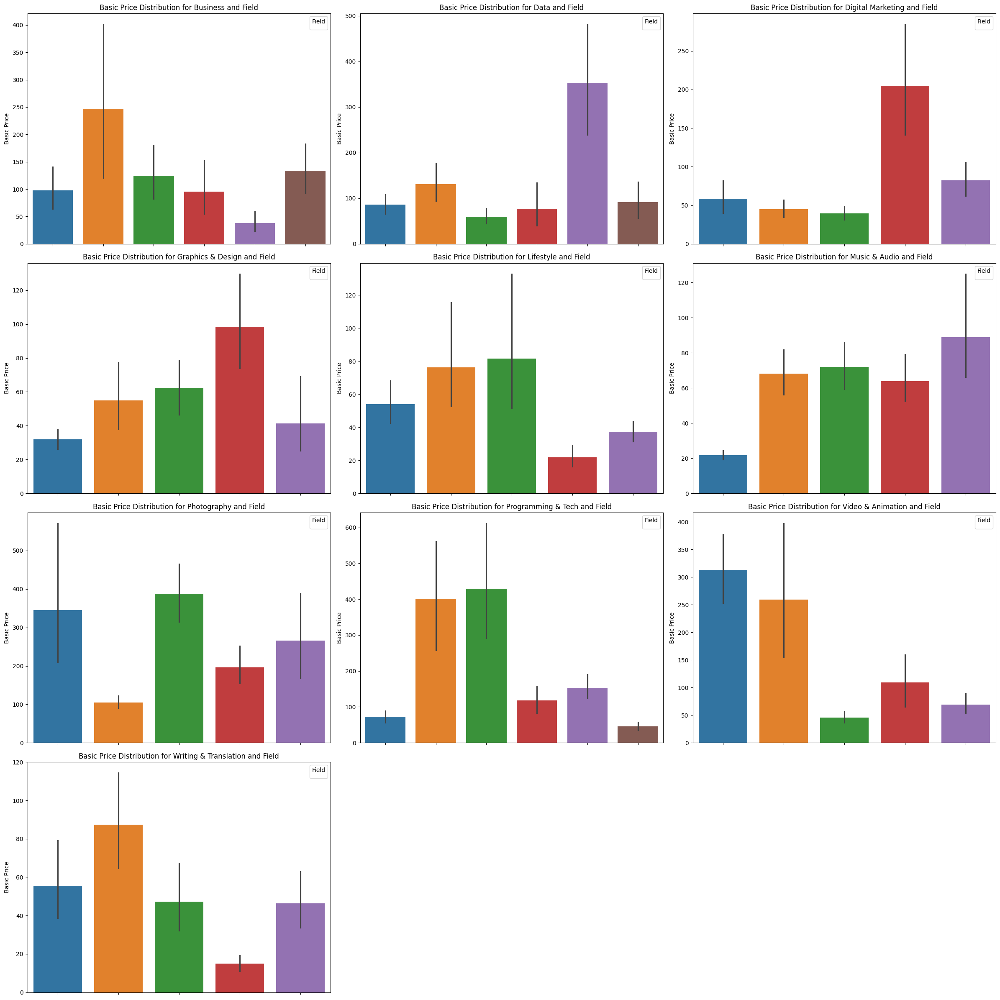

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that 

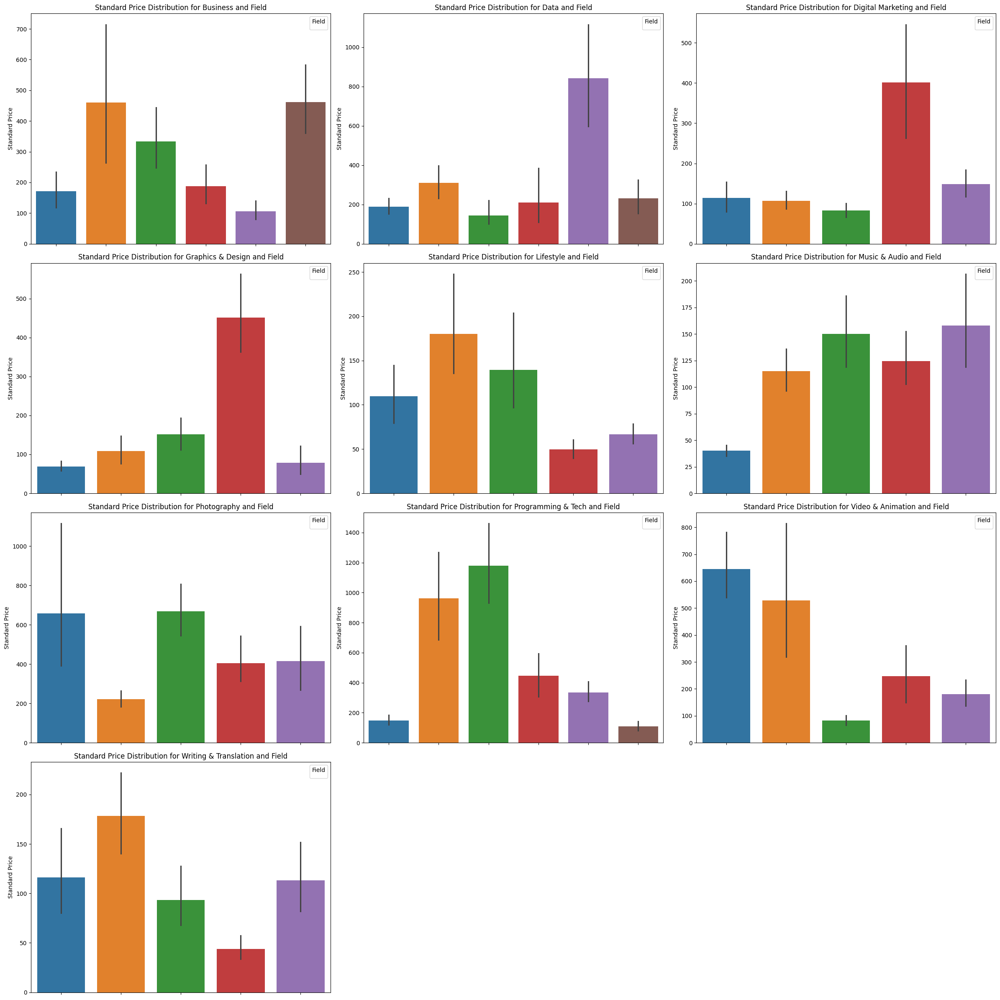

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that 

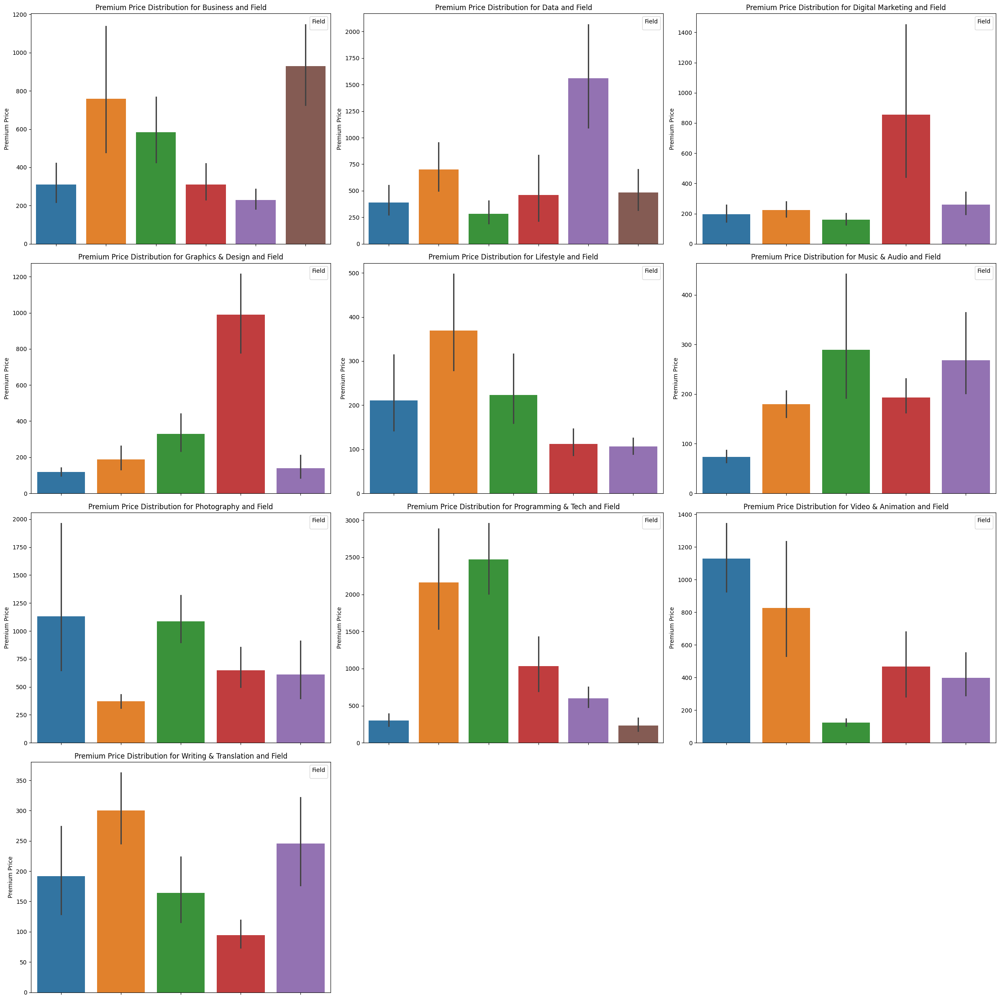

In [308]:
cat_plot_by_category(df_multi_plan, "Field", "Basic Price")
cat_plot_by_category(df_multi_plan, "Field", "Standard Price")
cat_plot_by_category(df_multi_plan, "Field", "Premium Price")

In [311]:
df.to_csv("EDA_df.csv", index=False)